# Exploratory Data Analysis (EDA) - Tennessee Eastman Process

- Obejtivo:
    -  Estabelecer uma compreensão inicial das características do banco obtido, assim como do comportamento dinâmico das variáveis monitoradas. 


- Pré-requisitos:
    - A data e o horário de cada instância devem ser registrados em uma coluna denominada de timestamps.
    - Os rótulos de cada instância devem ser registrados em uma coluna denominada de STATUS.


- Análises:
    - Matriz de correlação
    - Distribuição dos estados do processo
    - Histogramas
    - Boxplots e gráficos de violino
    - Estatísticas descritas
    - Cartas de controle univariadas

## Bibliotecas

In [1]:
import datetime
import math
import warnings

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from collections import Counter
from matplotlib.collections import LineCollection
from matplotlib.colors import ListedColormap, BoundaryNorm

warnings.simplefilter(action='ignore', category=FutureWarning)
warnings.simplefilter(action='ignore', category=DeprecationWarning)

In [2]:
saving_path = r"C:\Users\anaso\Desktop\workspace\doutorado\imagens"

## Funções

In [3]:
def print_overview(data):
    
    """
    Retorna algumas informações gerais sobre o banco de dados, como existência de nulos e duplicatas, dentre outros.
    """
    
    # Shape do banco
    print("Shape do banco: ", data.shape)
    
    # Alguma linha com todos os valores zerados?
    zero_rows = data.index[(data==0).all(axis=1)].tolist()
    print("\nQuantidade de linhas zeradas: ", len(zero_rows))
    
    # Existem nulos?
    print("Quantidade de nulos no banco: ", data.isnull().sum().sum())
    
    # Há duplicatas baseado no timestamp?
    qtd_duplis = len(data[data.duplicated(['timestamp'])])
    if (qtd_duplis > 0):
        print("Quantidade de duplicatas: ", qtd_duplis)
        print(data[data.duplicated(['timestamp'])])
    else:
        print("\nNão há registros duplicados.")
    
    # Alguma coluna possui um único valor constante?
    single_values_columns = []
    for col in (data.columns):
        unique_values = data[col].nunique()
        if (unique_values == 1):
            single_values_columns.append(col)
    if len(single_values_columns) > 0:
        print("Existem " + str(len(single_values_columns)) + " colunas constantes. São elas: " + single_values_columns)
    else:
        print("Não há colunas constantes.")
    
    # Alguma linha inteiramente zerada?
    data_sem_dt = data.drop(['timestamp'], 1)
    zero_rows = data_sem_dt.index[(data_sem_dt == 0).all(axis=1)].tolist()
    if len(zero_rows) > 0:
        print("Existem " + str(len(zero_rows)) + " linhas inteiramente zeradas.")
    else:
        print("Não há linhas inteiramente zeradas.")
    
    # Alguma linha com todas as colunas NaN?
    nan_rows = data.index[(data == float('nan')).all(axis=1)].tolist()
    if len(nan_rows) > 0:
        print("Existem " + str(len(nan_rows)) + " instâncias sem registro.")
    else:
        print("Não há linhas inteiramente sem registro (nan).")

In [4]:
def plot_comparison(x, title):
    
    """
    Constroi o histograma, o gráfico de caixas (boxplot) e o gráfico de violino para a variável definida.
    """
    
    fig, ax = plt.subplots(3, 1, sharex=True, figsize=(8,5), dpi=100)
    
    sns.distplot(x, ax=ax[0])
    ax[0].set_title('Histograma', fontsize=14)
    ax[0].set(ylabel='Densidade')
    
    sns.boxplot(x, ax=ax[1])
    ax[1].set_title('Boxplot', fontsize=14)
    ax[1].set(xlabel=None)
    
    sns.violinplot(x, ax=ax[2])
    ax[2].set_title('Gráfico de violino', fontsize=14)
    
#     fig.suptitle(title, fontsize=12)
    fig.tight_layout()
    
#     fig.savefig(saving_path + '/hist_box_viol.png', format='png')
    
    plt.show()

## Dados

In [5]:
data = pd.read_csv(r"D:\TEP - Python\09-python_dados-3anos.csv", sep=';').drop(['Unnamed: 0'], axis=1)
params_treino_python = pd.read_csv("D:\\TEP - Python\\09-params-3anos.csv", sep=';')

In [6]:
# Inclusão de uma coluna com timestamps genéricos

base = pd.to_datetime('2019-01-01') # data de início

date_list = [base + datetime.timedelta(minutes=3*x) for x in range(0, len(data))]
date_frame = pd.DataFrame(date_list, columns=['timestamp'])

data = pd.concat([date_frame, data], axis=1)
data.head()

,timestamp,XMEAS(1),XMEAS(2),XMEAS(3),XMEAS(4),XMEAS(5),XMEAS(6),XMEAS(7),XMEAS(8),XMEAS(9),...,XMV(3),XMV(4),XMV(5),XMV(6),XMV(7),XMV(8),XMV(9),XMV(10),XMV(11),STATUS
0,2019-01-01 00:00:00,0.249016,3669.257897,4501.008339,9.449552,27.320996,42.458404,2706.337423,74.639042,120.395689,...,24.791894,59.817988,22.565112,40.376400,34.307493,47.537449,47.579946,41.236066,19.582030,0
1,2019-01-01 00:03:00,0.249237,3691.240035,4508.871049,9.427162,26.827658,42.794460,2704.601116,74.721139,120.399265,...,24.770164,60.017714,22.025944,40.136342,35.598661,46.813031,47.642137,41.274444,15.144564,0
2,2019-01-01 00:06:00,0.250876,3668.163387,4527.323295,9.351588,27.010365,42.365508,2703.925678,74.373236,120.384636,...,24.616765,60.958098,22.407444,39.949611,40.251257,45.183418,47.464785,40.641116,18.231768,0
3,2019-01-01 00:09:00,0.249720,3669.158307,4460.623257,9.471787,26.652186,42.666696,2704.341391,75.455363,120.401539,...,24.730399,60.730999,22.270945,40.343303,37.656724,40.288922,47.502494,41.786003,20.035613,0
4,2019-01-01 00:12:00,0.241266,3652.137947,4515.510160,9.440549,26.890053,42.300660,2704.921507,74.301383,120.401877,...,24.191091,60.496433,22.434775,39.836905,40.873778,45.941358,47.469312,41.792575,15.925366,0


In [7]:
print("Min. timestamp: ", data.timestamp.min())
print("Max. timestamp: ", data.timestamp.max())

Min. timestamp:  2019-01-01 00:00:00
Max. timestamp:  2021-12-30 23:57:00


## Análises gráficas e indicadores

### Informações gerais

In [8]:
# Informações gerais sobre o banco

print_overview(data)

Shape do banco:  (525600, 54)

Quantidade de linhas zeradas:  0
Quantidade de nulos no banco:  0

Não há registros duplicados.
Não há colunas constantes.
Não há linhas inteiramente zeradas.
Não há linhas inteiramente sem registro (nan).


In [ ]:
data.columns

In [9]:
# Estatísticas descritivas gerais do banco de dados

data.describe()[1:].T

,mean,std,min,25%,50%,75%,max
XMEAS(1),0.264141,0.104521,-0.003742,0.225065,0.252682,0.281169,1.014465
XMEAS(2),3664.533177,37.254145,3438.498450,3640.083354,3664.555667,3689.107030,3872.810999
XMEAS(3),4512.349010,74.086054,3785.469019,4476.974559,4510.077246,4544.358656,5147.181635
XMEAS(4),9.341857,0.206927,7.475963,9.271361,9.348438,9.426317,11.239152
XMEAS(5),26.901826,0.225139,25.508943,26.755399,26.901342,27.048428,28.351327
XMEAS(6),42.346950,0.250759,40.487978,42.182815,42.344738,42.508520,43.985984
XMEAS(7),2705.391255,26.508883,2490.338156,2697.464219,2704.595324,2711.807568,2998.232138
XMEAS(8),74.999532,0.901522,67.078739,74.567076,74.999639,75.432723,84.720007
XMEAS(9),120.399997,0.059994,119.639191,120.385863,120.400251,120.414857,120.933803
XMEAS(10),0.349257,0.071654,0.105907,0.326922,0.337398,0.348227,0.800646


In [10]:
# Informações sobre os tipos dos dados presentes no banco

data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 525600 entries, 0 to 525599
Data columns (total 54 columns):
 #   Column     Non-Null Count   Dtype         
---  ------     --------------   -----         
 0   timestamp  525600 non-null  datetime64[ns]
 1   XMEAS(1)   525600 non-null  float64       
 2   XMEAS(2)   525600 non-null  float64       
 3   XMEAS(3)   525600 non-null  float64       
 4   XMEAS(4)   525600 non-null  float64       
 5   XMEAS(5)   525600 non-null  float64       
 6   XMEAS(6)   525600 non-null  float64       
 7   XMEAS(7)   525600 non-null  float64       
 8   XMEAS(8)   525600 non-null  float64       
 9   XMEAS(9)   525600 non-null  float64       
 10  XMEAS(10)  525600 non-null  float64       
 11  XMEAS(11)  525600 non-null  float64       
 12  XMEAS(12)  525600 non-null  float64       
 13  XMEAS(13)  525600 non-null  float64       
 14  XMEAS(14)  525600 non-null  float64       
 15  XMEAS(15)  525600 non-null  float64       
 16  XMEAS(16)  525600 no

In [11]:
# Quantidade de instâncias por status

Counter(data['STATUS'])

Counter({0: 264912,
         16: 14440,
         12: 869,
         13: 11926,
         15: 13945,
         19: 14704,
         10: 16438,
         7: 16314,
         2: 19181,
         20: 19347,
         11: 12300,
         8: 16189,
         14: 17733,
         5: 14176,
         4: 12347,
         9: 17433,
         3: 14164,
         1: 12678,
         6: 1322,
         17: 14171,
         18: 1011})

In [12]:
# Dataframes auxiliares para análises posteriores

normal_data = data[data['STATUS'] == 0].copy()

faulty_data = data[data['STATUS'] != 0].copy()

In [13]:
# Skewness e kurtosis para o banco completo, e para os dados de operação normal e em falha separadamente

sk_kr = pd.DataFrame(data.kurt(), columns=['kurtosis_full'])
sk_kr['skewness_full'] = data.skew()

sk_kr['kurtosis_normal'] = normal_data.kurt()
sk_kr['skewness_normal'] = normal_data.skew()

sk_kr['kurtosis_faulty'] = faulty_data.kurt()
sk_kr['skewness_faulty'] = faulty_data.skew()

sk_kr[:-1]

,kurtosis_full,skewness_full,kurtosis_normal,skewness_normal,kurtosis_faulty,skewness_faulty
XMEAS(1),14.508283,3.027339,13.759383,1.568452,8.771196,2.601130
XMEAS(2),0.365917,-0.017501,0.344499,-0.026268,0.367054,-0.015793
XMEAS(3),6.222292,-0.036248,10.179145,-0.182493,3.932982,-0.001662
XMEAS(4),8.348789,-0.717237,13.976866,-0.193142,5.404178,-0.889838
XMEAS(5),0.819464,0.000419,-0.059524,0.002806,1.257928,0.000289
XMEAS(6),0.630595,0.030409,0.825180,-0.001459,0.444952,0.041573
XMEAS(7),17.486429,1.611113,26.465581,2.028929,12.608625,1.351202
XMEAS(8),8.576211,0.086497,9.854400,0.456084,7.438621,-0.232458
XMEAS(9),26.479706,-1.084161,90.870075,-3.568214,13.403819,-0.778605
XMEAS(10),18.145374,4.127353,52.887331,4.243844,8.079048,2.968529


In [14]:
# Matriz de correlação

data_corr = data.drop(['STATUS', 'timestamp'], axis=1).corr()
data_corr

,XMEAS(1),XMEAS(2),XMEAS(3),XMEAS(4),XMEAS(5),XMEAS(6),XMEAS(7),XMEAS(8),XMEAS(9),XMEAS(10),...,XMV(2),XMV(3),XMV(4),XMV(5),XMV(6),XMV(7),XMV(8),XMV(9),XMV(10),XMV(11)
XMEAS(1),1.000000,-0.157961,-0.300357,-0.599835,-0.001397,-0.070729,-0.247047,0.027911,0.031527,-0.059632,...,-0.301260,0.904292,-0.275208,-0.377886,-0.028376,0.032483,0.025431,0.165403,-0.087837,0.028181
XMEAS(2),-0.157961,1.000000,0.256986,0.159973,-0.008090,0.154692,0.259361,0.086573,0.069596,0.185425,...,0.257825,-0.157819,0.063686,0.230893,0.164611,-0.025796,-0.019988,-0.083969,0.140948,-0.024215
XMEAS(3),-0.300357,0.256986,1.000000,0.147521,-0.007021,0.071930,0.445985,0.393758,-0.048982,0.388780,...,0.806510,-0.300087,0.046985,0.391639,0.359618,-0.050601,-0.026707,-0.474524,0.063777,-0.059205
XMEAS(4),-0.599835,0.159973,0.147521,1.000000,0.004817,0.386183,0.195338,-0.468872,0.008279,0.422879,...,0.149088,-0.551536,0.329801,0.397477,0.384616,-0.049250,-0.035773,0.018098,0.173200,-0.134367
XMEAS(5),-0.001397,-0.008090,-0.007021,0.004817,1.000000,0.027341,-0.003799,-0.014014,-0.014665,0.002363,...,-0.008599,-0.001604,0.008626,0.056127,0.001860,-0.001138,0.000441,0.003975,-0.008913,-0.005241
XMEAS(6),-0.070729,0.154692,0.071930,0.386183,0.027341,1.000000,0.099806,-0.253954,0.016338,0.318962,...,0.072864,-0.075091,0.157929,0.169787,0.300378,-0.024887,-0.015081,0.059370,0.097236,-0.078855
XMEAS(7),-0.247047,0.259361,0.445985,0.195338,-0.003799,0.099806,1.000000,0.238622,-0.025331,-0.018294,...,0.446608,-0.170499,0.089491,0.675450,-0.074304,-0.042320,-0.056434,0.023071,0.091420,0.079381
XMEAS(8),0.027911,0.086573,0.393758,-0.468872,-0.014014,-0.253954,0.238622,1.000000,-0.038477,-0.121702,...,0.392709,0.022290,-0.233639,-0.028294,-0.113307,0.002488,0.003924,-0.370248,-0.082009,0.092941
XMEAS(9),0.031527,0.069596,-0.048982,0.008279,-0.014665,0.016338,-0.025331,-0.038477,1.000000,0.001269,...,-0.050280,0.029531,0.003298,-0.037292,0.003794,0.006037,0.005320,0.014949,0.754374,-0.006659
XMEAS(10),-0.059632,0.185425,0.388780,0.422879,0.002363,0.318962,-0.018294,-0.121702,0.001269,1.000000,...,0.389964,-0.064846,0.154701,0.010783,0.995568,-0.040890,-0.010548,-0.321816,0.058124,-0.169988


### Análises gráficas

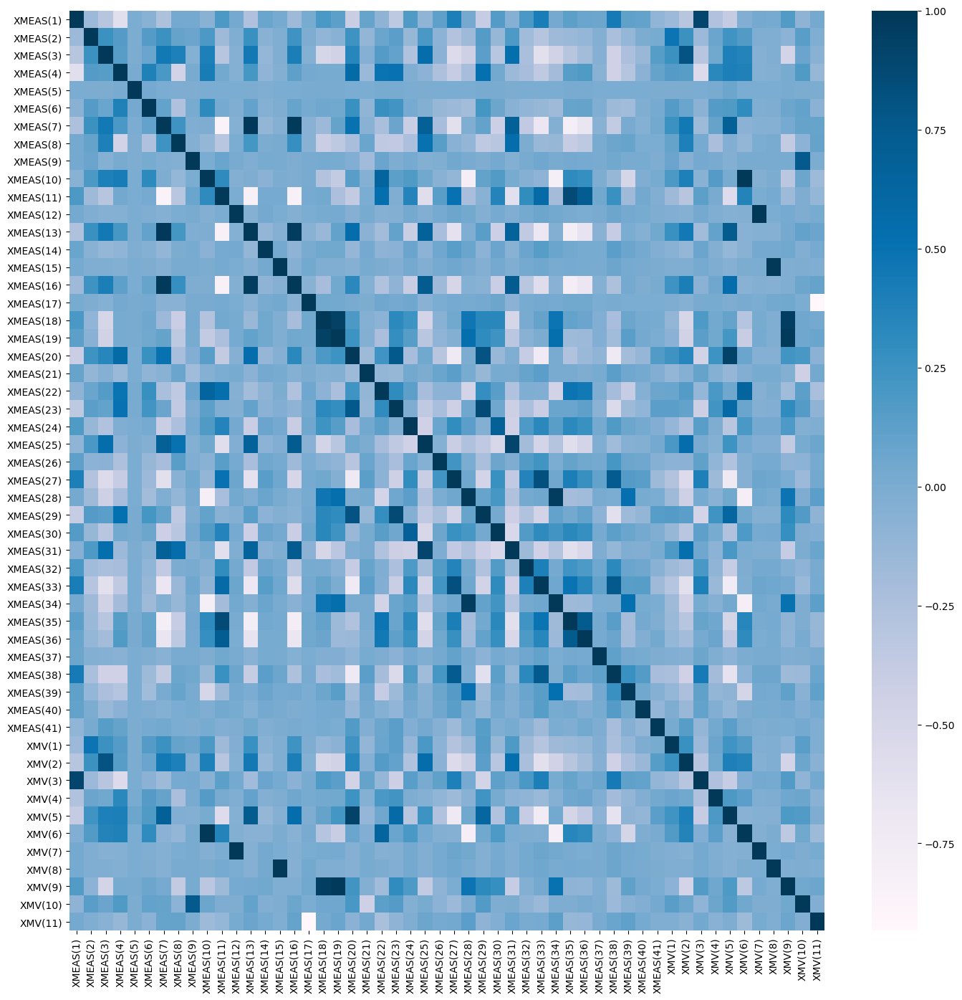

In [15]:
# Matriz de correlação

data_corr = data.drop(['STATUS', 'timestamp'], axis=1).corr()
plt.figure(figsize=(17,17), dpi=100)
ax = sns.heatmap(data_corr, cmap='PuBu')
plt.show();

ax.figure.savefig(saving_path + "/confusion_matrix_heatmap.png")

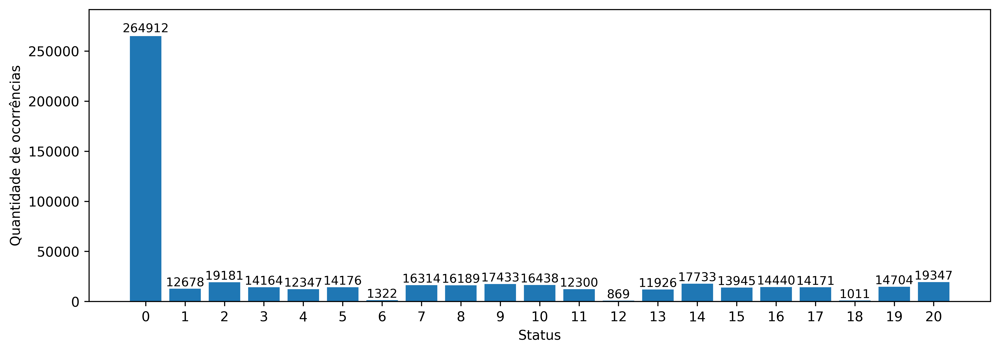

In [16]:
# Gráfico da quantidade de ocorrências de cada estado do processo - cenário multiclasse

status_counter = Counter(data['STATUS'])

plt.figure(figsize=(12,4), dpi=600)
plt.xlabel("Status"); plt.ylabel("Quantidade de ocorrências")
plt.margins(0.05, 0.1)
plt.xticks(np.arange(0, 21, 1))
plot = plt.bar(status_counter.keys(), status_counter.values())

for rectangle in plot:
    height = rectangle.get_height()
    plt.text(rectangle.get_x() + rectangle.get_width()/2., 1.005*height, '%d' % int(height), \
             ha='center', va='bottom', fontsize=9)

plt.savefig(saving_path + '/num_status_multiclasse.png', format='png')

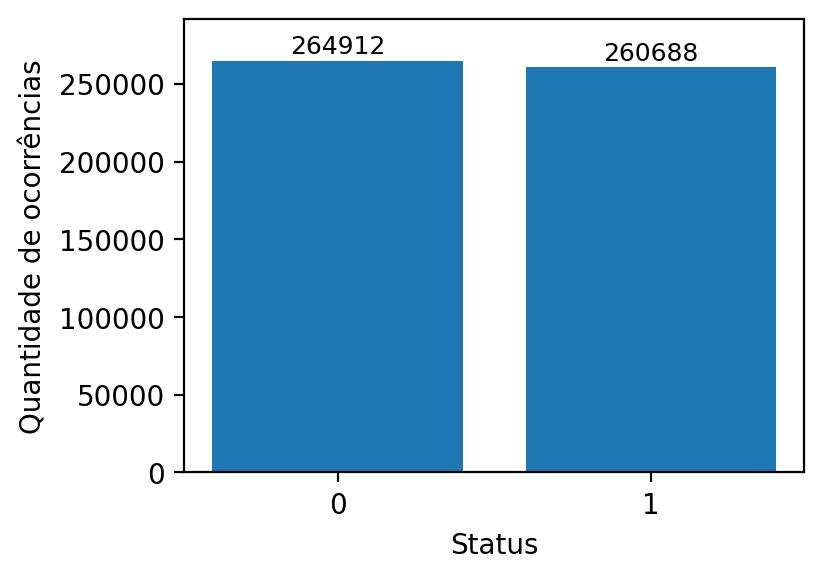

In [17]:
# Gráfico da quantidade de ocorrências de cada estado do processo - cenário binário

data_bin = data.copy()
data_bin['STATUS'] = np.where(data_bin['STATUS'] != 0, 1, data_bin['STATUS'])

status_counter = Counter(data_bin['STATUS'])

plt.figure(figsize=(4,3), dpi=200)
plt.xlabel("Status"); plt.ylabel("Quantidade de ocorrências")
plt.margins(0.05, 0.1)
plt.xticks(np.arange(0, 2, 1))
plot = plt.bar(status_counter.keys(), status_counter.values())

for rectangle in plot:
    height = rectangle.get_height()
    plt.text(rectangle.get_x() + rectangle.get_width()/2., 1.005*height, '%d' % int(height), \
             ha='center', va='bottom', fontsize=9)

plt.savefig(saving_path + '/num_status_bin.png', format='png')

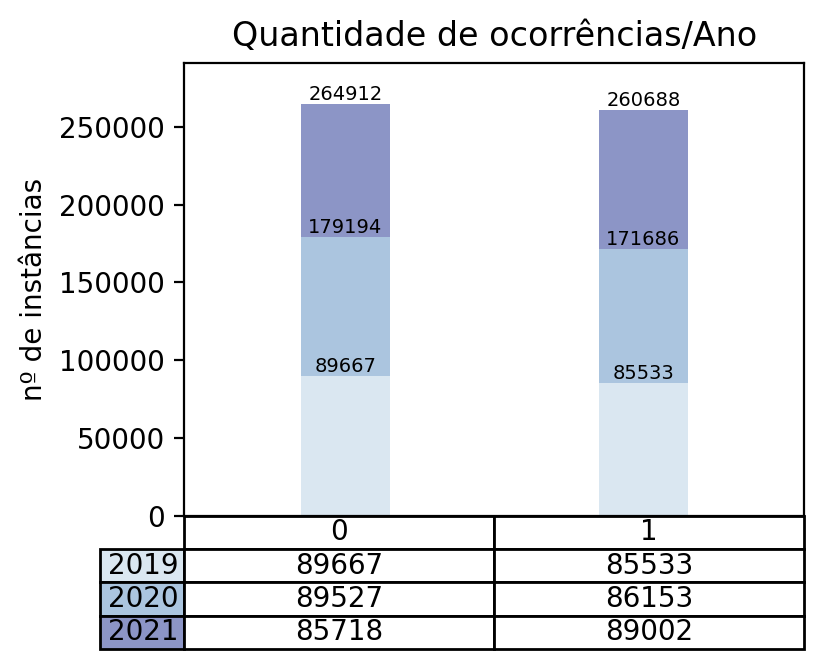

In [18]:
# Gráfico da distribuição binária por ano 
    # Os labels do gráfico estão empilhados, logo, o último label é a quantidade total de registros de cada status

data_bin['year'] = data_bin.timestamp.dt.year

dict_status_year = {}

# Cria um dicionário de listas
# Cada lista armazena a quantidade de instâncias de cada estado do processo (em ordem)
for year in data_bin.year.unique():
    
    list_status_year = []
    data_year = data_bin[data_bin['year'] == year]
    
    for s in np.sort(data_year.STATUS.unique()):
        
        status_qtd_per_year = len(data_year[data_year['STATUS'] == s])
        list_status_year.append(status_qtd_per_year)
        
    dict_status_year[year] = list_status_year

years = data_bin['year'].unique()
data_bin.drop(['year'], axis=1, inplace=True)

columns = np.sort(data_bin['STATUS'].unique())

# Configurações para o gráfico
colors = plt.cm.BuPu(np.linspace(0.15, 0.5, len(years)))
index = np.arange(len(columns)) 
bar_width = 0.3
plt.figure(figsize=(4,3), dpi=200)
plt.margins(0.3, 0.1)

cell_text_table = []
n_rows = len(dict_status_year)
y_offset = np.zeros(len(columns))

for row in range(n_rows):
    plot = plt.bar(index, dict_status_year[years[row]], bar_width, bottom=y_offset, color=colors[row], align='edge')
    y_offset = y_offset + dict_status_year[years[row]]
    cell_text_table.append(['%1.0f' % (x) for x in dict_status_year[years[row]]])
    i=0
    
    # Cada iteração deste loop rotula cada bar com o valor correspondente
    for rect in plot:
        height = rect.get_height()
        plt.text(rect.get_x() + rect.get_width()/2, y_offset[i],'%d' % int(y_offset[i]), \
                 ha='center', va='bottom', fontsize=7)
        i=i+1

# Adiciona uma tabela abaixo do eixo x do gráfico
the_table = plt.table(cellText=cell_text_table, rowLabels=years, rowColours=colors, cellLoc='center', colLabels=columns, loc='bottom')
plt.ylabel("nº de instâncias")
plt.xticks([])
plt.title('Quantidade de ocorrências/Ano')
plt.show()

the_table.figure.savefig(saving_path + '/num_status_bin_empilhado.png', format='png')

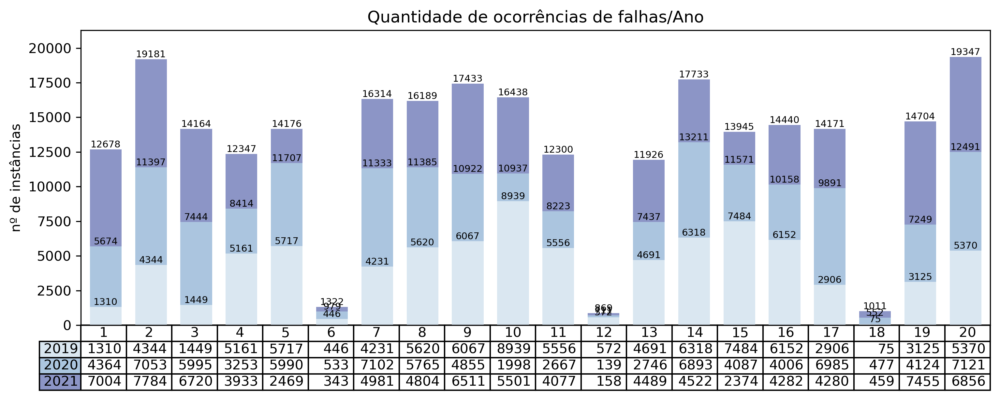

In [19]:
# Gráfico da distribuição das falhas por ano 
    # Os labels do gráfico estão empilhados, logo, o último label é a quantidade total de registros de cada falha

data['year'] = data.timestamp.dt.year

dict_status_year = {}

# Cria um dicionário de listas
# Cada lista armazena a quantidade de instâncias de cada estado do processo (em ordem)
for year in data.year.unique():
    
    list_status_year = []
    data_year = data[data['year'] == year]
    
    for s in np.sort(data_year.STATUS.unique()):
        
        status_qtd_per_year = len(data_year[data_year['STATUS'] == s])
        list_status_year.append(status_qtd_per_year)
        
    dict_status_year[year] = list_status_year

years = data['year'].unique()
data.drop(['year'], axis=1, inplace=True)

columns = np.sort(data['STATUS'].unique())[1:]

# Configurações para o gráfico
colors = plt.cm.BuPu(np.linspace(0.15, 0.5, len(years)))
index = np.arange(len(columns)+1) 
bar_width = 0.7
plt.figure(figsize=(12,4), dpi=300)
plt.margins(0.01, 0.1)

cell_text_table = []
n_rows = len(dict_status_year)
y_offset = np.zeros(len(columns))

for row in range(n_rows):
    plot = plt.bar(index[1:], dict_status_year[years[row]][1:], bar_width, bottom=y_offset, color=colors[row], align='edge')
    y_offset = y_offset + dict_status_year[years[row]][1:]
    cell_text_table.append(['%1.0f' % (x) for x in dict_status_year[years[row]][1:]])
    i=0
    
    # Cada iteração deste loop rotula cada bar com o valor correspondente
    for rect in plot:
        height = rect.get_height()
        plt.text(rect.get_x() + rect.get_width()/2, y_offset[i],'%d' % int(y_offset[i]), \
                 ha='center', va='bottom', fontsize=7)
        i=i+1
    
# Adiciona uma tabela abaixo do eixo x do gráfico
the_table = plt.table(cellText=cell_text_table, rowLabels=years, rowColours=colors, colLabels=columns, loc='bottom')
plt.ylabel("nº de instâncias")
plt.xticks([])
plt.title('Quantidade de ocorrências de falhas/Ano')
plt.show()

the_table.figure.savefig(saving_path + '/num_status_empilhado.png', format='png')

### Cenários - Dados normais

C:\Users\anaso\AppData\Local\Continuum\anaconda3\envs\doc-ana\lib\site-packages\pandas\plotting\_matplotlib\tools.py:400: MatplotlibDeprecationWarning: 
The is_first_col function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use ax.get_subplotspec().is_first_col() instead.
  if ax.is_first_col():
C:\Users\anaso\AppData\Local\Continuum\anaconda3\envs\doc-ana\lib\site-packages\pandas\plotting\_matplotlib\tools.py:400: MatplotlibDeprecationWarning: 
The is_first_col function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use ax.get_subplotspec().is_first_col() instead.
  if ax.is_first_col():
C:\Users\anaso\AppData\Local\Continuum\anaconda3\envs\doc-ana\lib\site-packages\pandas\plotting\_matplotlib\tools.py:400: MatplotlibDeprecationWarning: 
The is_first_col function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use ax.get_subplotspec().is_first_col() instead.
  if ax.is_first_col():
C:\User

C:\Users\anaso\AppData\Local\Continuum\anaconda3\envs\doc-ana\lib\site-packages\pandas\plotting\_matplotlib\tools.py:400: MatplotlibDeprecationWarning: 
The is_first_col function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use ax.get_subplotspec().is_first_col() instead.
  if ax.is_first_col():
C:\Users\anaso\AppData\Local\Continuum\anaconda3\envs\doc-ana\lib\site-packages\pandas\plotting\_matplotlib\tools.py:400: MatplotlibDeprecationWarning: 
The is_first_col function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use ax.get_subplotspec().is_first_col() instead.
  if ax.is_first_col():
C:\Users\anaso\AppData\Local\Continuum\anaconda3\envs\doc-ana\lib\site-packages\pandas\plotting\_matplotlib\tools.py:400: MatplotlibDeprecationWarning: 
The is_first_col function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use ax.get_subplotspec().is_first_col() instead.
  if ax.is_first_col():
C:\User

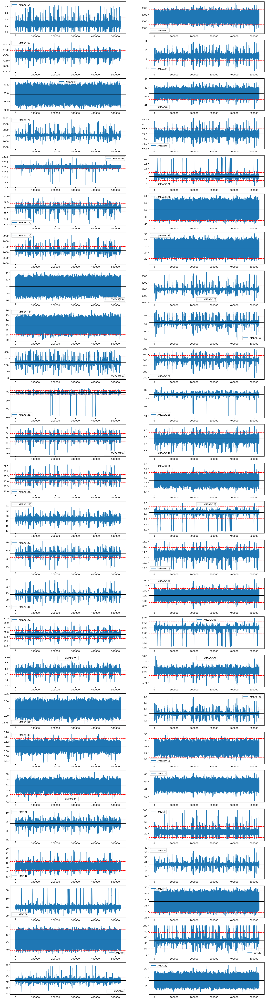

In [20]:
normal_to_plot = normal_data.drop(['STATUS', 'timestamp'], axis=1)

# Dataframe para armazenar estatísticas calculadas
carta_stats = pd.DataFrame(np.zeros((normal_to_plot.shape[1],4)), columns=['mean', 'std', 'LCL', 'UCL'])

# Instanciamento dos subplots
fig, ax = plt.subplots(math.ceil(normal_to_plot.shape[1]/2), 2, figsize=(20,80), dpi=100)

for i in range(normal_to_plot.shape[1]):
    
    x = normal_to_plot.iloc[:,i]
    
    mean  = x.mean()
    std = x.std(ddof=1)
    
    LCL = mean-3*std
    UCL = mean+3*std
    
    # Guardando variáveis
    carta_stats['mean'].iloc[i] = mean
    carta_stats['std'].iloc[i] = std
    carta_stats['LCL'].iloc[i] = LCL
    carta_stats['UCL'].iloc[i] = UCL

    x = normal_to_plot.iloc[:,i]
    x.plot(ax=ax.ravel()[i]) 

    ax.ravel()[i].legend();
    ax.ravel()[i].axhline(carta_stats['mean'][i],c='k')
    ax.ravel()[i].axhline(carta_stats['LCL'][i],ls='--',c='r')
    ax.ravel()[i].axhline(carta_stats['UCL'][i],ls='--',c='r')

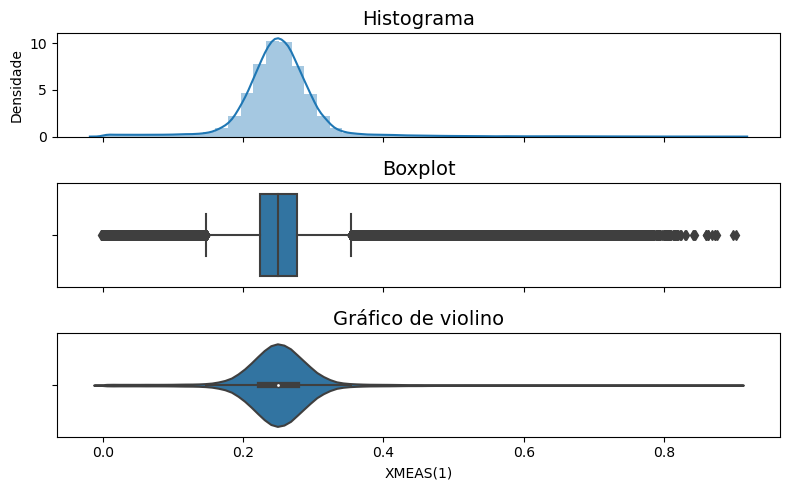

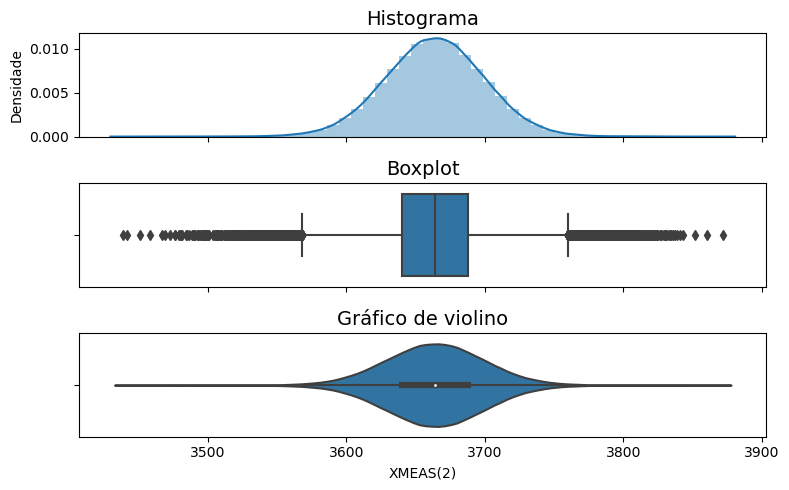

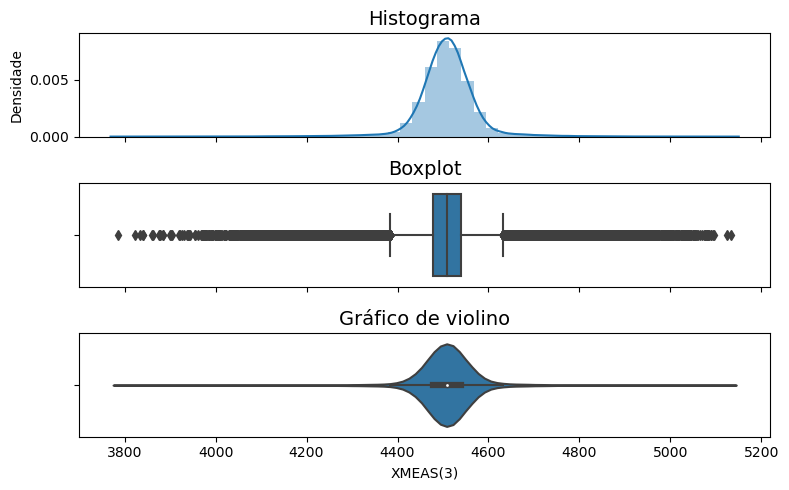

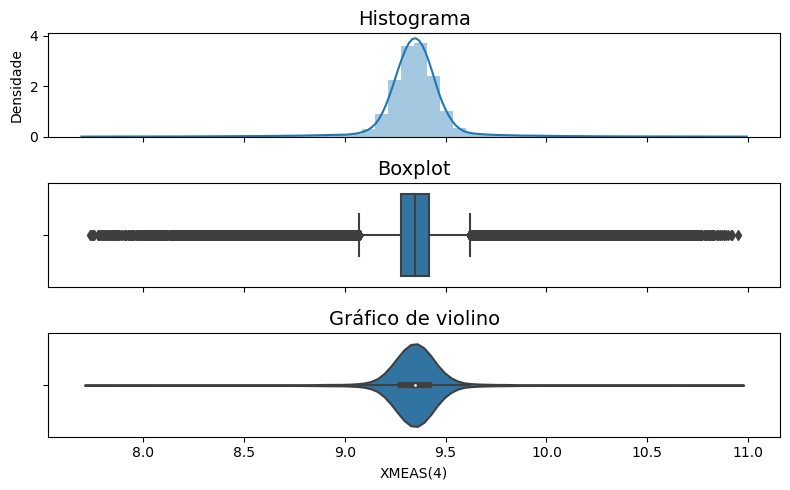

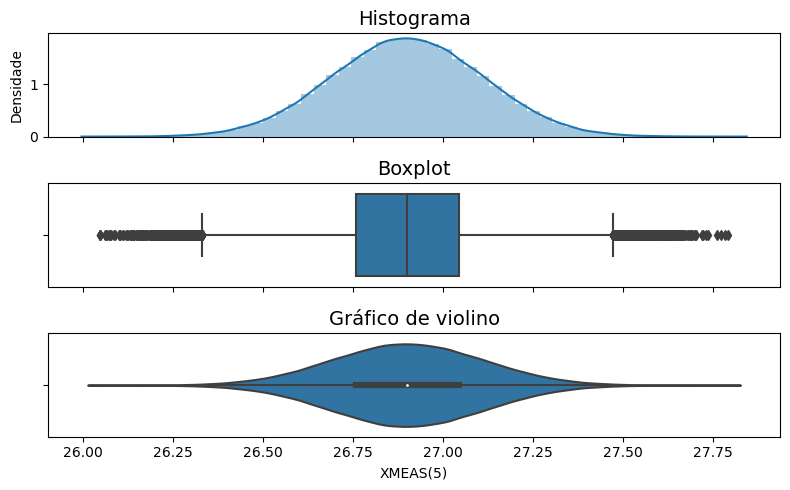

...

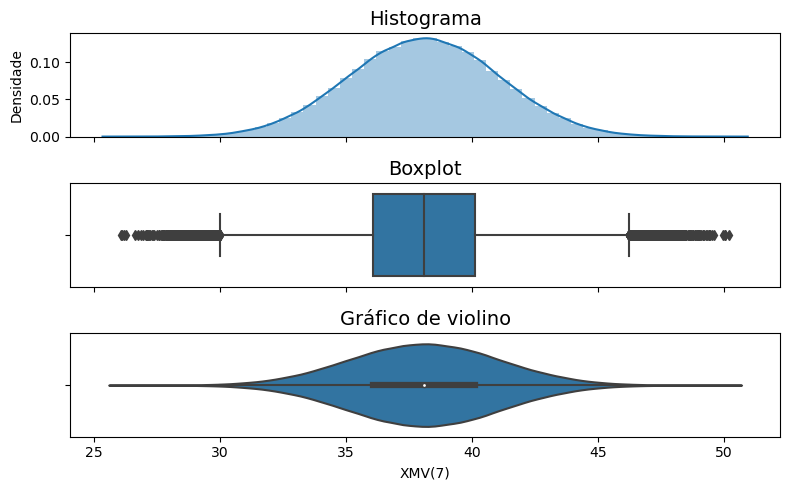

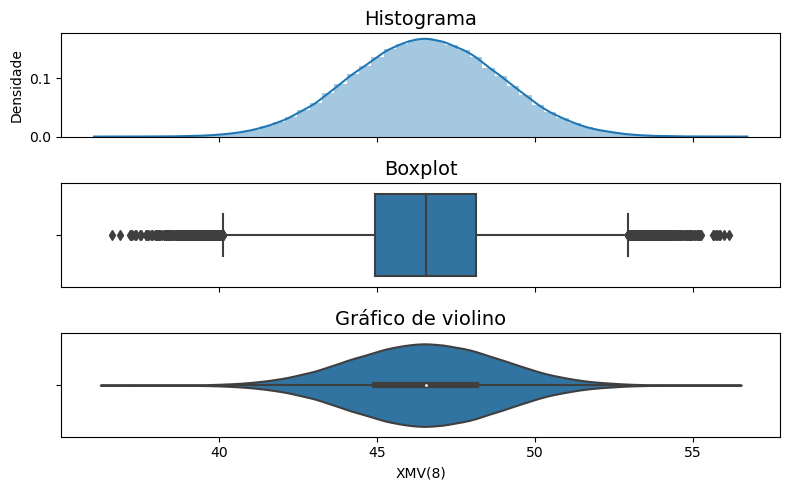

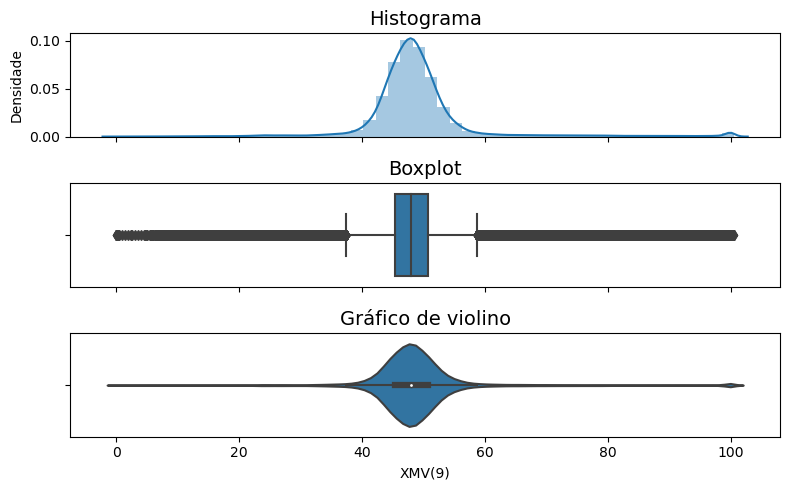

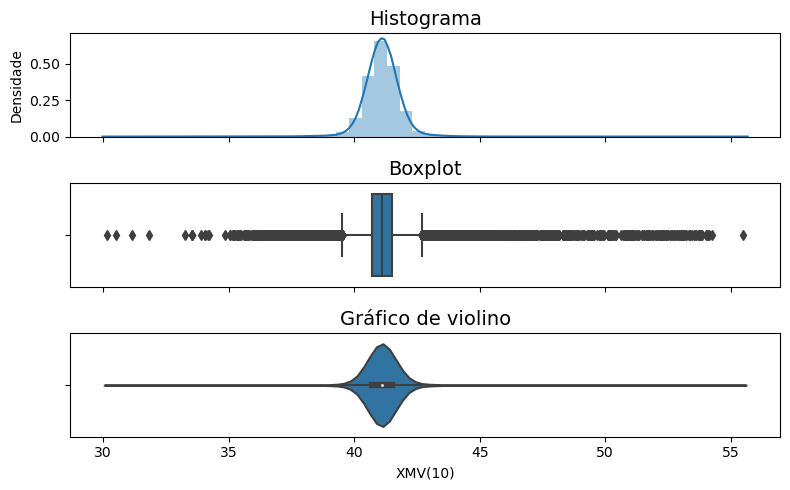

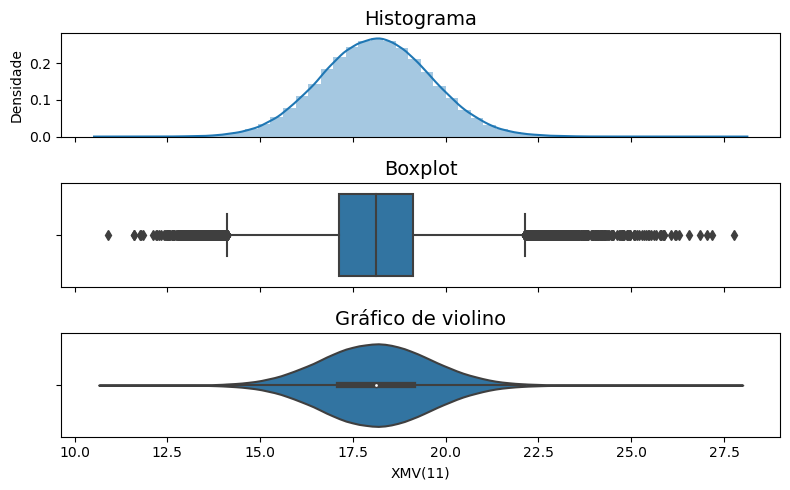

In [21]:
# Histograma / Boxplot / Gráfico de violino

for col in normal_to_plot.columns:
    plot_comparison(normal_to_plot[col], col)

### Cenários - Dados em falha

C:\Users\anaso\AppData\Local\Continuum\anaconda3\envs\doc-ana\lib\site-packages\pandas\plotting\_matplotlib\tools.py:400: MatplotlibDeprecationWarning: 
The is_first_col function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use ax.get_subplotspec().is_first_col() instead.
  if ax.is_first_col():
C:\Users\anaso\AppData\Local\Continuum\anaconda3\envs\doc-ana\lib\site-packages\pandas\plotting\_matplotlib\tools.py:400: MatplotlibDeprecationWarning: 
The is_first_col function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use ax.get_subplotspec().is_first_col() instead.
  if ax.is_first_col():
C:\Users\anaso\AppData\Local\Continuum\anaconda3\envs\doc-ana\lib\site-packages\pandas\plotting\_matplotlib\tools.py:400: MatplotlibDeprecationWarning: 
The is_first_col function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use ax.get_subplotspec().is_first_col() instead.
  if ax.is_first_col():
C:\User

C:\Users\anaso\AppData\Local\Continuum\anaconda3\envs\doc-ana\lib\site-packages\pandas\plotting\_matplotlib\tools.py:400: MatplotlibDeprecationWarning: 
The is_first_col function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use ax.get_subplotspec().is_first_col() instead.
  if ax.is_first_col():
C:\Users\anaso\AppData\Local\Continuum\anaconda3\envs\doc-ana\lib\site-packages\pandas\plotting\_matplotlib\tools.py:400: MatplotlibDeprecationWarning: 
The is_first_col function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use ax.get_subplotspec().is_first_col() instead.
  if ax.is_first_col():
C:\Users\anaso\AppData\Local\Continuum\anaconda3\envs\doc-ana\lib\site-packages\pandas\plotting\_matplotlib\tools.py:400: MatplotlibDeprecationWarning: 
The is_first_col function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use ax.get_subplotspec().is_first_col() instead.
  if ax.is_first_col():
C:\User

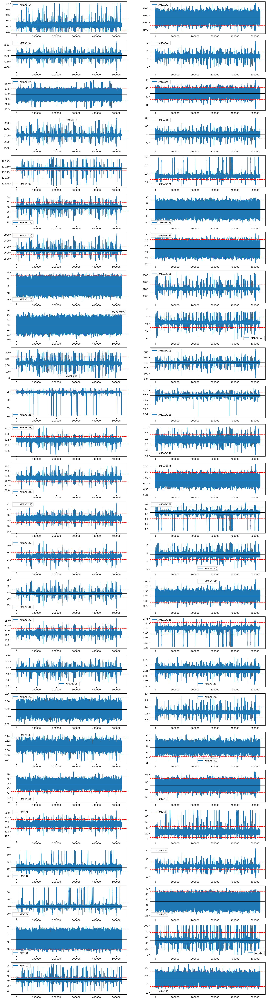

In [22]:
# Cartas univariadas dos dados em falha, mas utilizando os limites calculados com os dados normais

faulty_to_plot = faulty_data.drop(['STATUS', 'timestamp'], axis=1)
fig, ax = plt.subplots(math.ceil(faulty_to_plot.shape[1]/2), 2, figsize=(20,80), dpi=100)

for i in range(faulty_to_plot.shape[1]):
    
    x = faulty_to_plot.iloc[:,i]
    x.plot(ax=ax.ravel()[i]) 

    ax.ravel()[i].legend();
    ax.ravel()[i].axhline(carta_stats['mean'][i],c='k')
    ax.ravel()[i].axhline(carta_stats['LCL'][i],ls='--',c='r')
    ax.ravel()[i].axhline(carta_stats['UCL'][i],ls='--',c='r')

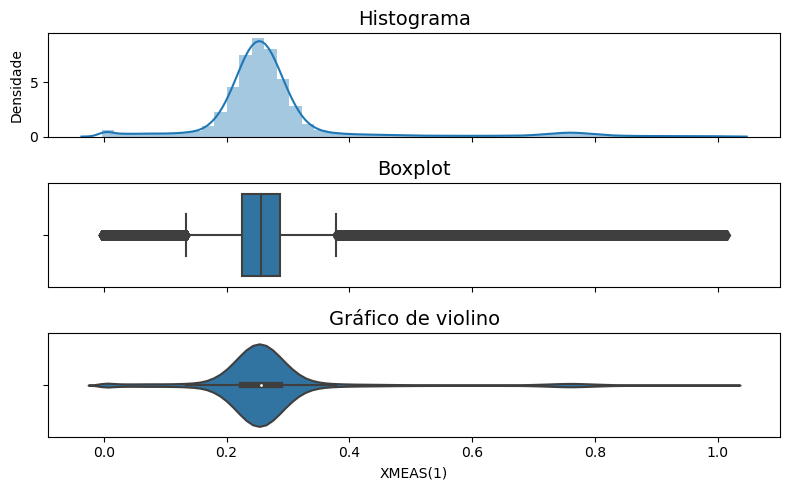

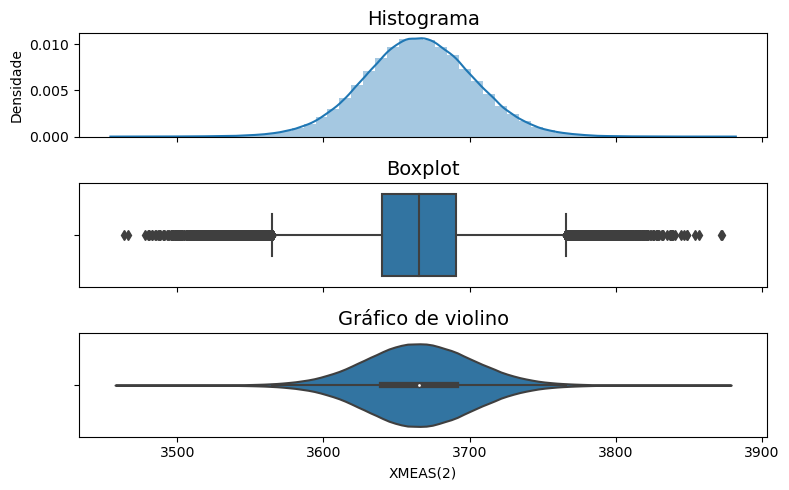

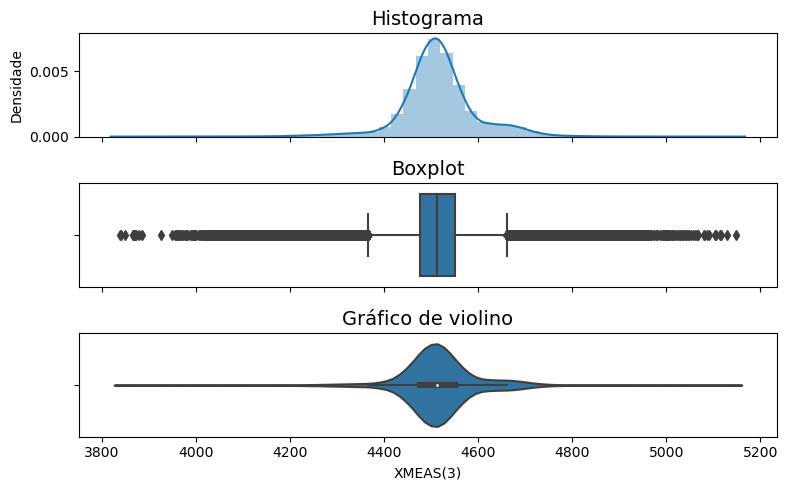

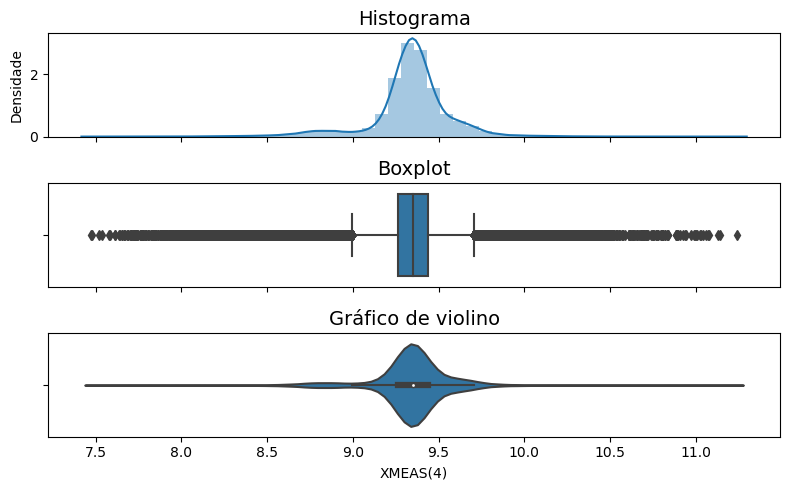

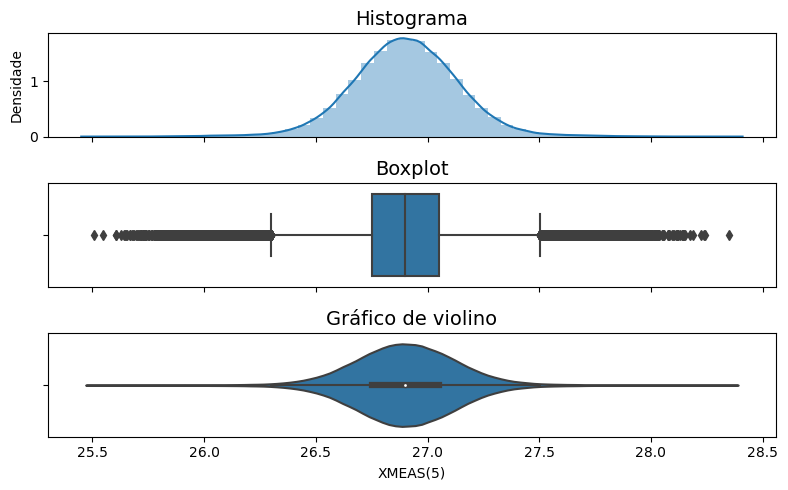

...

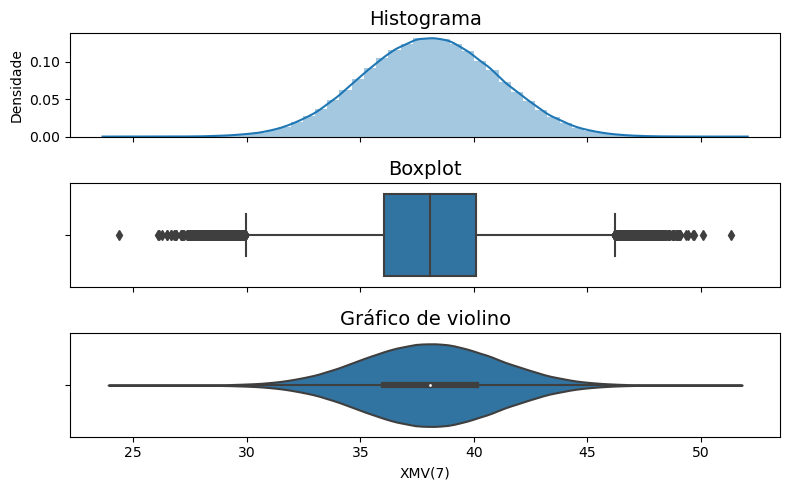

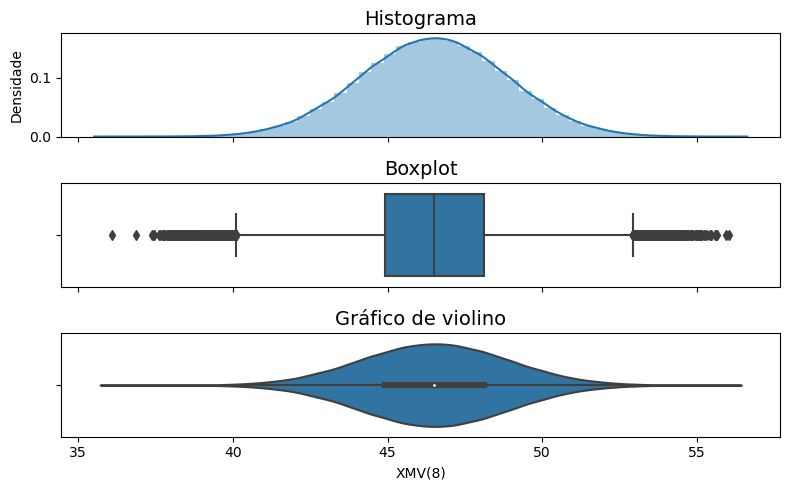

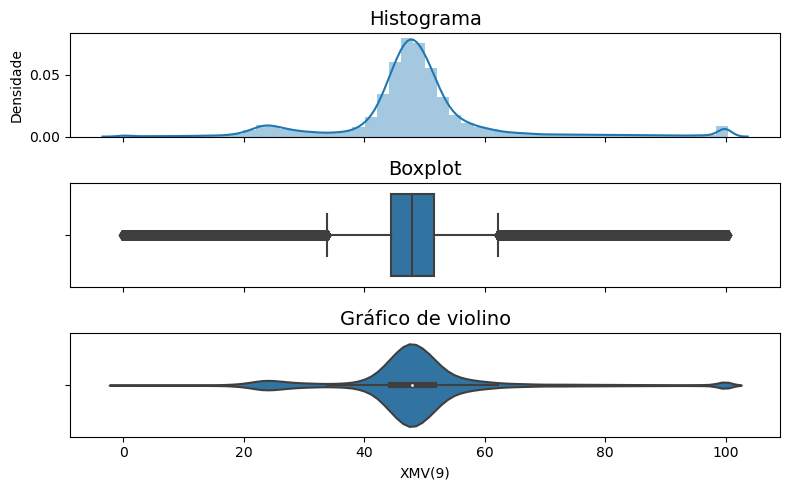

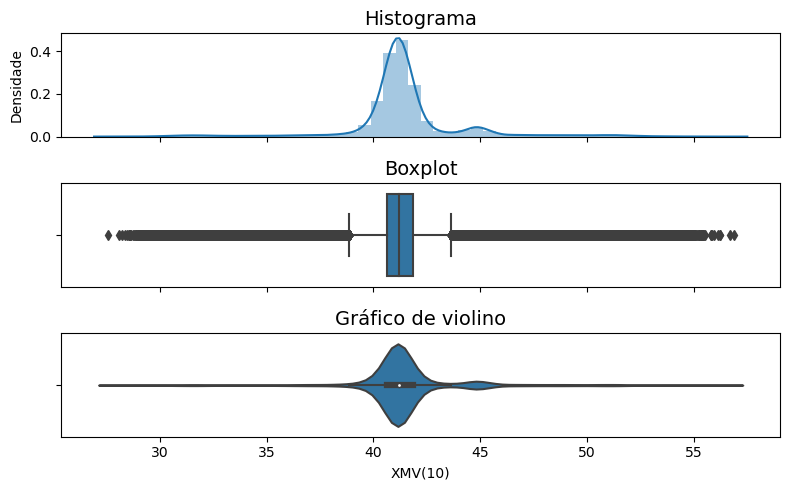

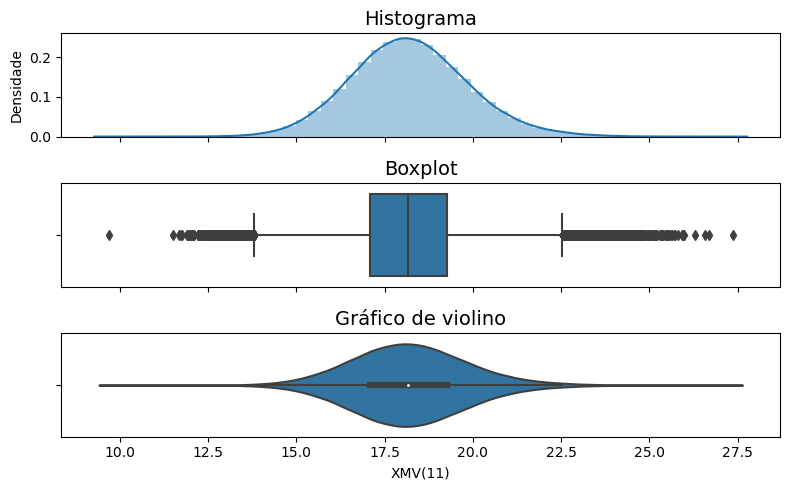

In [23]:
# Histograma / Boxplot / Gráfico de violino

for col in faulty_to_plot.columns:
    plot_comparison(faulty_to_plot[col], col)

### Cenários - Dados totais

C:\Users\anaso\AppData\Local\Continuum\anaconda3\envs\doc-ana\lib\site-packages\pandas\plotting\_matplotlib\tools.py:400: MatplotlibDeprecationWarning: 
The is_first_col function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use ax.get_subplotspec().is_first_col() instead.
  if ax.is_first_col():
C:\Users\anaso\AppData\Local\Continuum\anaconda3\envs\doc-ana\lib\site-packages\pandas\plotting\_matplotlib\tools.py:400: MatplotlibDeprecationWarning: 
The is_first_col function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use ax.get_subplotspec().is_first_col() instead.
  if ax.is_first_col():
C:\Users\anaso\AppData\Local\Continuum\anaconda3\envs\doc-ana\lib\site-packages\pandas\plotting\_matplotlib\tools.py:400: MatplotlibDeprecationWarning: 
The is_first_col function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use ax.get_subplotspec().is_first_col() instead.
  if ax.is_first_col():
C:\User

C:\Users\anaso\AppData\Local\Continuum\anaconda3\envs\doc-ana\lib\site-packages\pandas\plotting\_matplotlib\tools.py:400: MatplotlibDeprecationWarning: 
The is_first_col function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use ax.get_subplotspec().is_first_col() instead.
  if ax.is_first_col():
C:\Users\anaso\AppData\Local\Continuum\anaconda3\envs\doc-ana\lib\site-packages\pandas\plotting\_matplotlib\tools.py:400: MatplotlibDeprecationWarning: 
The is_first_col function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use ax.get_subplotspec().is_first_col() instead.
  if ax.is_first_col():
C:\Users\anaso\AppData\Local\Continuum\anaconda3\envs\doc-ana\lib\site-packages\pandas\plotting\_matplotlib\tools.py:400: MatplotlibDeprecationWarning: 
The is_first_col function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use ax.get_subplotspec().is_first_col() instead.
  if ax.is_first_col():
C:\User

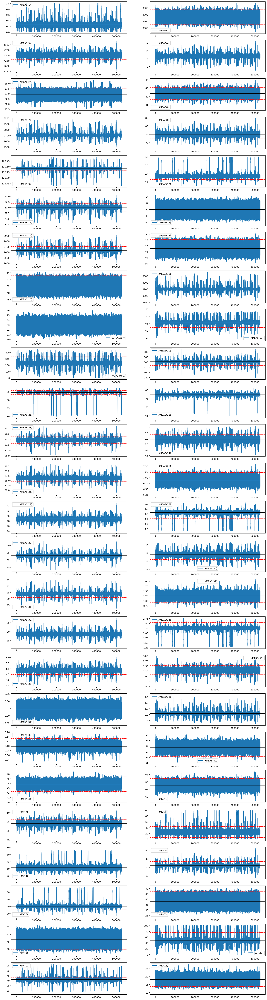

In [24]:
# Cartas univariadas dos dados totais, mas utilizando os limites calculados com os dados normais

total_to_plot = data.drop(['STATUS', 'timestamp'], axis=1)
fig, ax = plt.subplots(math.ceil(total_to_plot.shape[1]/2), 2, figsize=(20,80), dpi=100)

for i in range(total_to_plot.shape[1]):
    
    x = total_to_plot.iloc[:,i]
    x.plot(ax=ax.ravel()[i]) 

    ax.ravel()[i].legend();
    ax.ravel()[i].axhline(carta_stats['mean'][i],c='k')
    ax.ravel()[i].axhline(carta_stats['LCL'][i],ls='--',c='r')
    ax.ravel()[i].axhline(carta_stats['UCL'][i],ls='--',c='r')

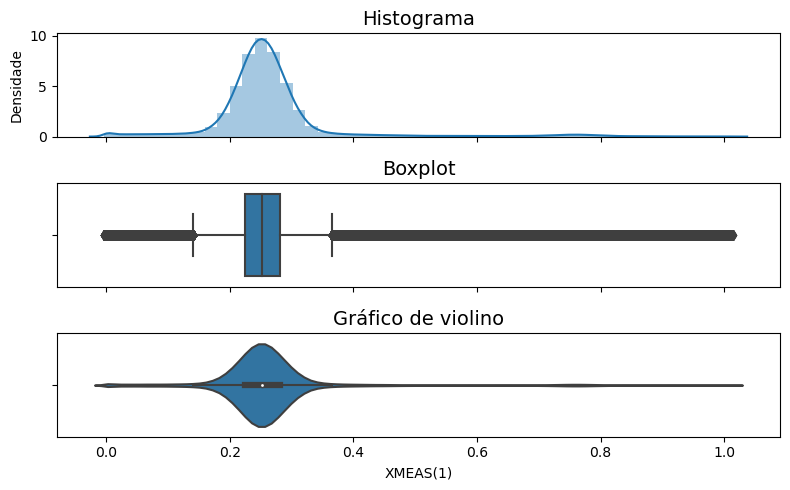

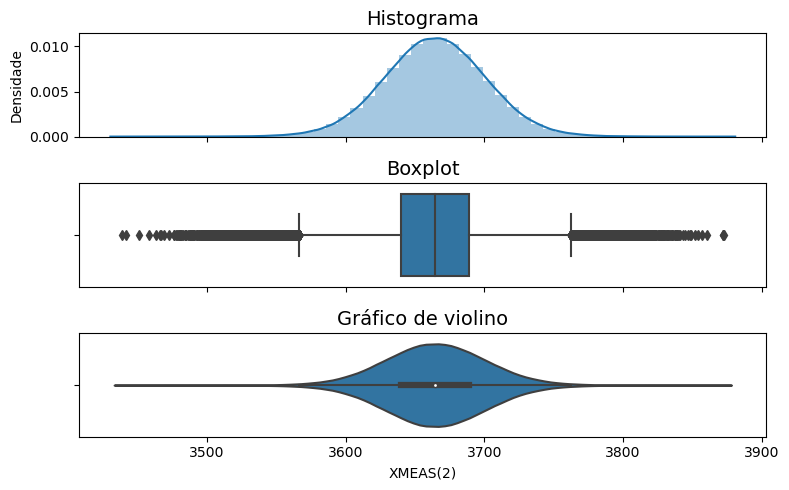

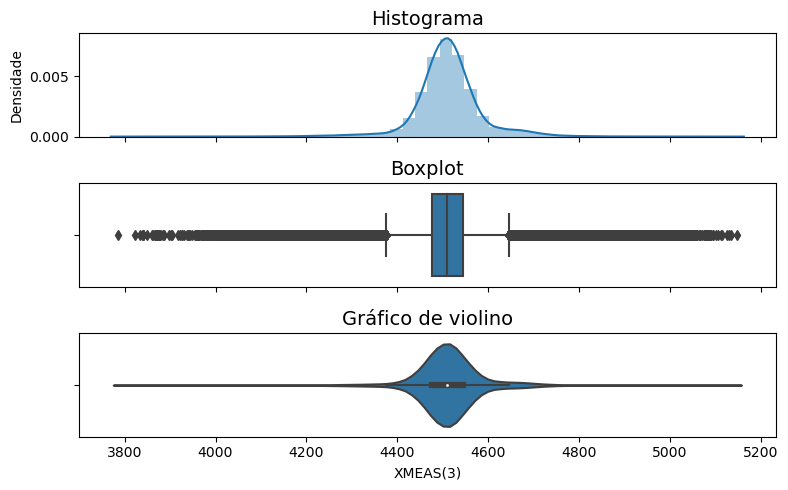

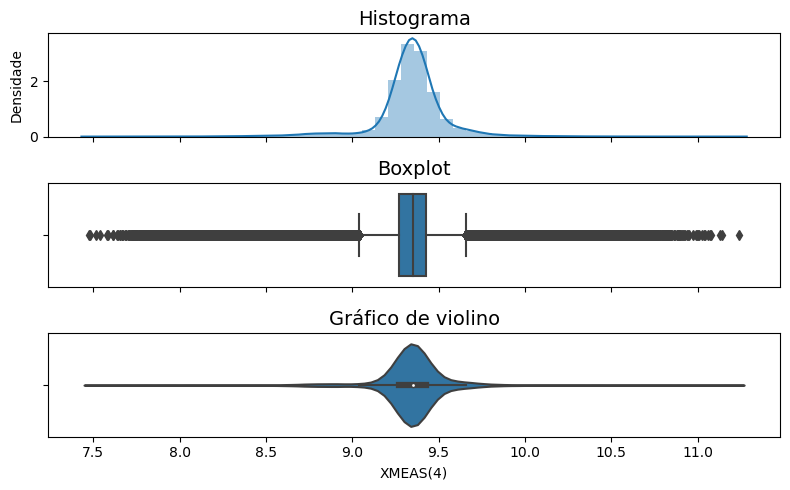

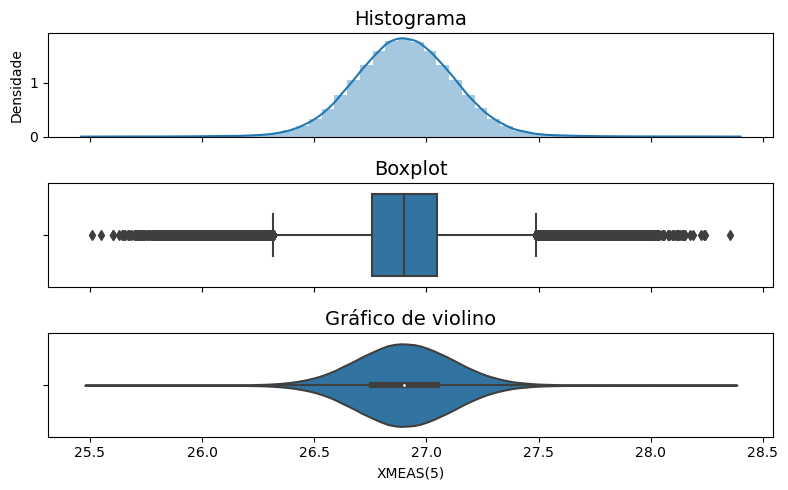

...

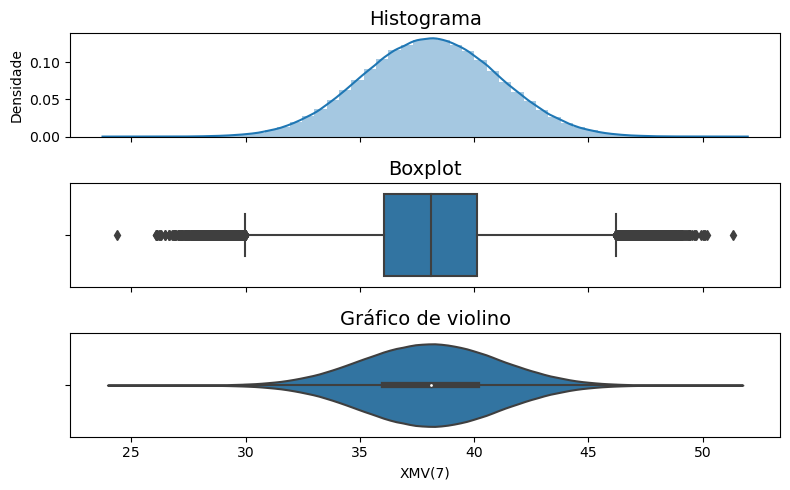

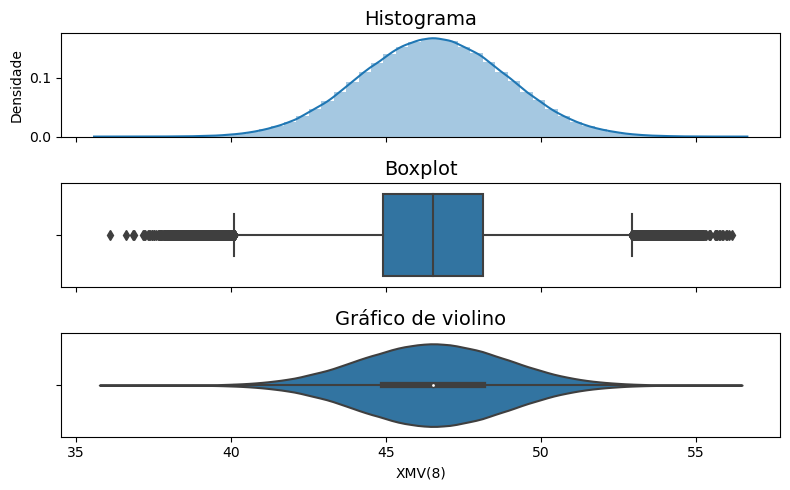

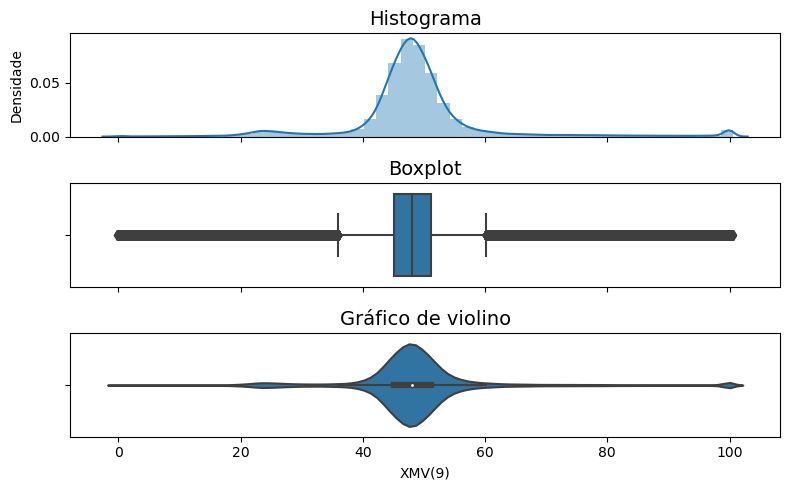

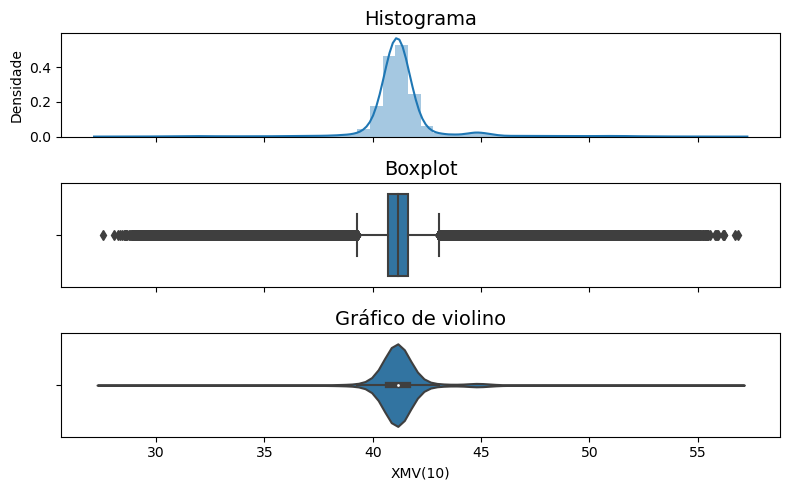

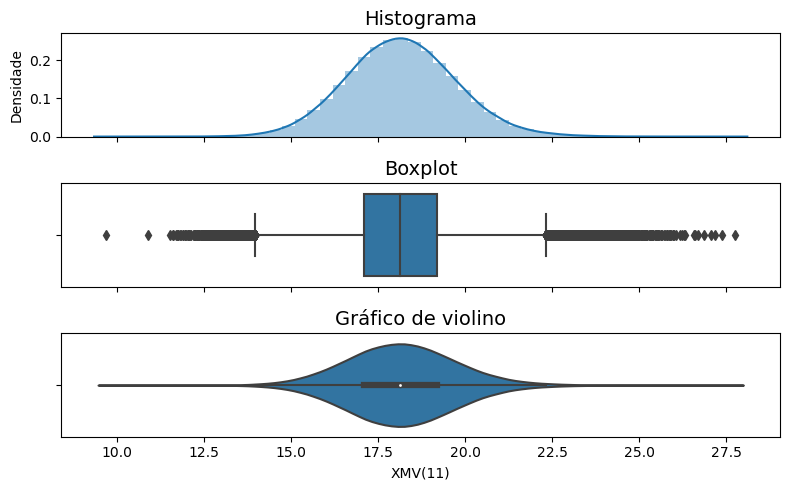

In [25]:
# Histograma / Boxplot / Gráfico de violino

for col in total_to_plot.columns:
    plot_comparison(total_to_plot[col], col)

### Cenários - Falha 1


(1000, 54)
Min. timestamp:  2019-04-14 03:00:00
Max. timestamp:  2019-04-16 04:57:00


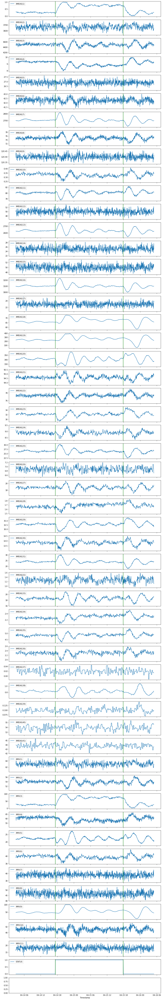

In [26]:
fig, ax = plt.subplots(nrows=data.shape[1], ncols=1, sharex=True, figsize=(15,100))
columns = data.columns[1:]

fault_data = data[49500:50500].copy()

print()
print(fault_data.shape)
print("Min. timestamp: ", fault_data['timestamp'].min())
print("Max. timestamp: ", fault_data['timestamp'].max())

for i in range (fault_data.shape[1]-1):

    ax[i].plot(fault_data['timestamp'], fault_data[columns[i]], label=columns[i])
    ax[i].legend(loc='upper left')
    
    ax[i].axvline(fault_data[fault_data['STATUS'] != 0].timestamp.min(), c='green')
    ax[i].axvline(fault_data[fault_data['STATUS'] != 0].timestamp.max(), c='green')

plt.xlabel('Timestamp');

C:\Users\anaso\AppData\Local\Continuum\anaconda3\envs\doc-ana\lib\site-packages\pandas\plotting\_matplotlib\tools.py:400: MatplotlibDeprecationWarning: 
The is_first_col function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use ax.get_subplotspec().is_first_col() instead.
  if ax.is_first_col():
C:\Users\anaso\AppData\Local\Continuum\anaconda3\envs\doc-ana\lib\site-packages\pandas\plotting\_matplotlib\tools.py:400: MatplotlibDeprecationWarning: 
The is_first_col function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use ax.get_subplotspec().is_first_col() instead.
  if ax.is_first_col():
C:\Users\anaso\AppData\Local\Continuum\anaconda3\envs\doc-ana\lib\site-packages\pandas\plotting\_matplotlib\tools.py:400: MatplotlibDeprecationWarning: 
The is_first_col function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use ax.get_subplotspec().is_first_col() instead.
  if ax.is_first_col():
C:\User

C:\Users\anaso\AppData\Local\Continuum\anaconda3\envs\doc-ana\lib\site-packages\pandas\plotting\_matplotlib\tools.py:400: MatplotlibDeprecationWarning: 
The is_first_col function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use ax.get_subplotspec().is_first_col() instead.
  if ax.is_first_col():
C:\Users\anaso\AppData\Local\Continuum\anaconda3\envs\doc-ana\lib\site-packages\pandas\plotting\_matplotlib\tools.py:400: MatplotlibDeprecationWarning: 
The is_first_col function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use ax.get_subplotspec().is_first_col() instead.
  if ax.is_first_col():
C:\Users\anaso\AppData\Local\Continuum\anaconda3\envs\doc-ana\lib\site-packages\pandas\plotting\_matplotlib\tools.py:400: MatplotlibDeprecationWarning: 
The is_first_col function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use ax.get_subplotspec().is_first_col() instead.
  if ax.is_first_col():
C:\User

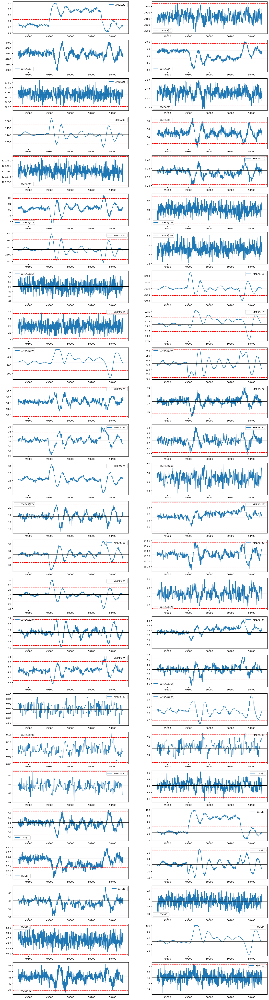

In [27]:
# Obtenção das cartas de controle

data_to_plot = fault_data.drop(['STATUS', 'timestamp'], axis=1)
fig, ax = plt.subplots(math.ceil(data_to_plot.shape[1]/2), 2, figsize=(20,80), dpi=100)

for i in range(data_to_plot.shape[1]):
    
    x = data_to_plot.iloc[:,i]
    x.plot(ax=ax.ravel()[i]) 

    ax.ravel()[i].legend();
    ax.ravel()[i].axhline(carta_stats['mean'][i],c='k')
    ax.ravel()[i].axhline(carta_stats['LCL'][i],ls='--',c='r')
    ax.ravel()[i].axhline(carta_stats['UCL'][i],ls='--',c='r')

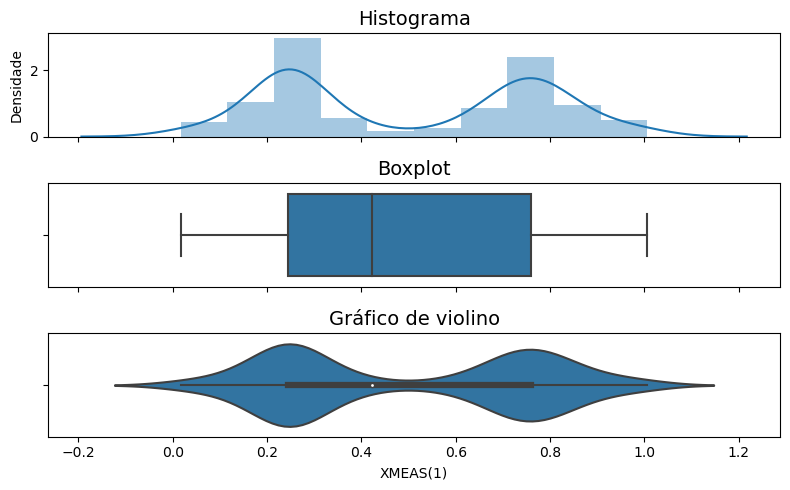

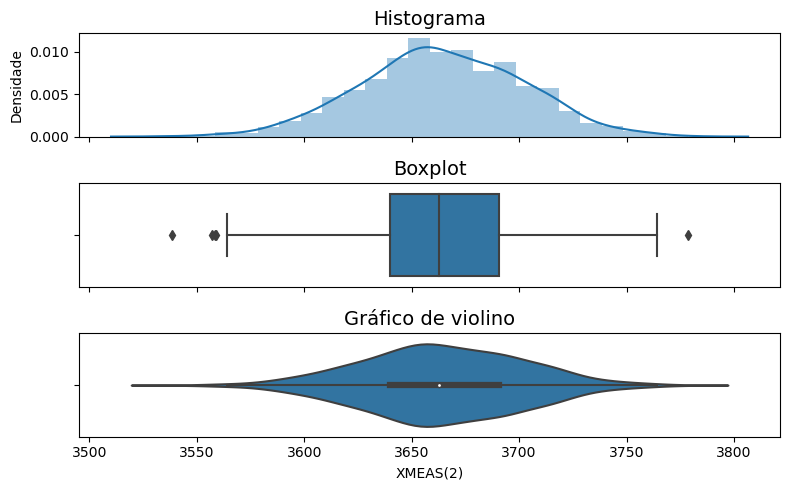

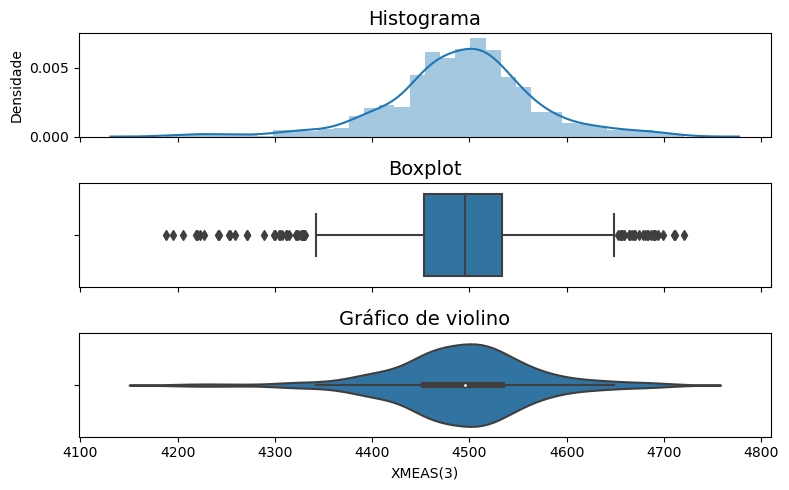

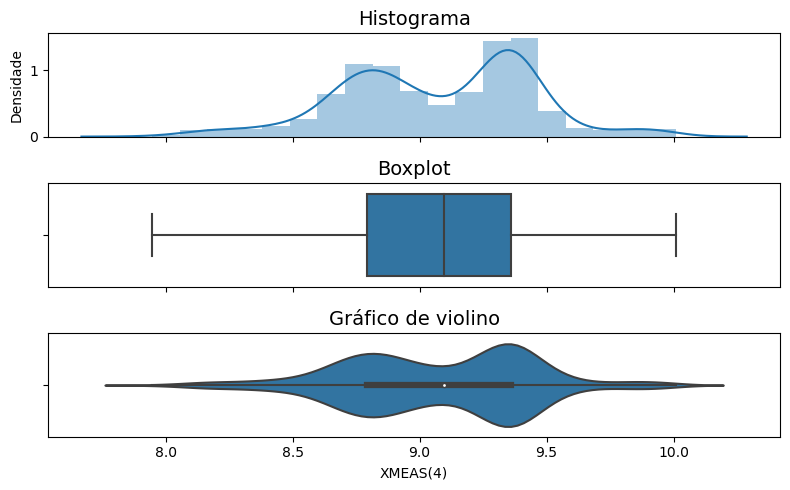

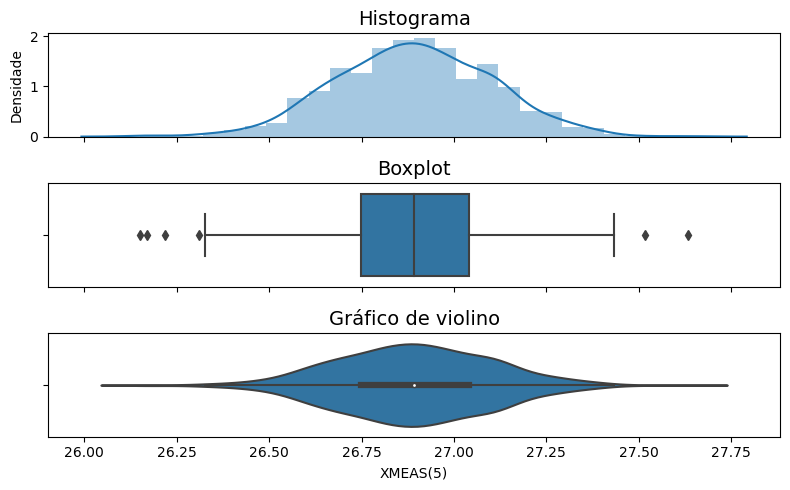

...

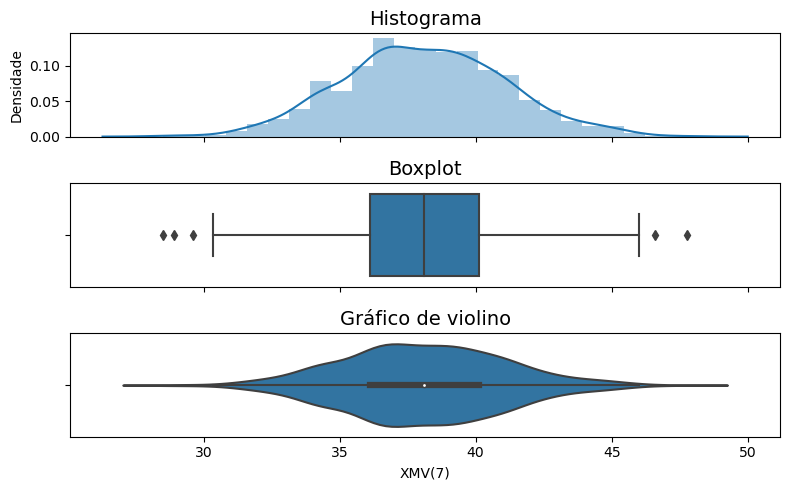

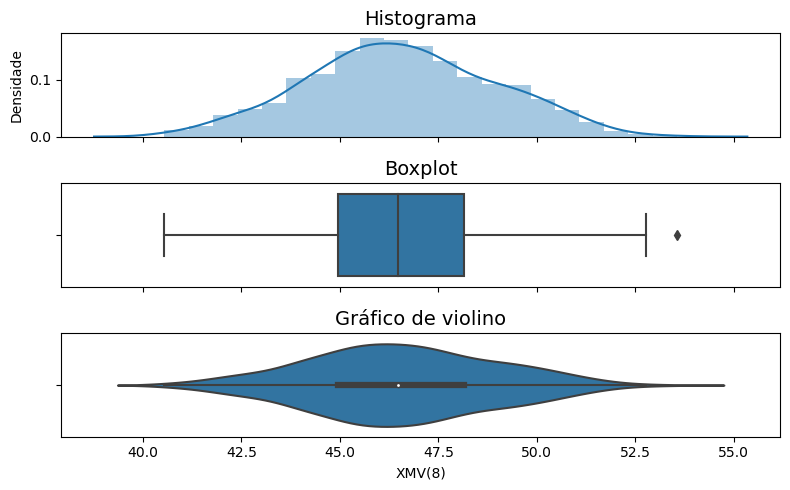

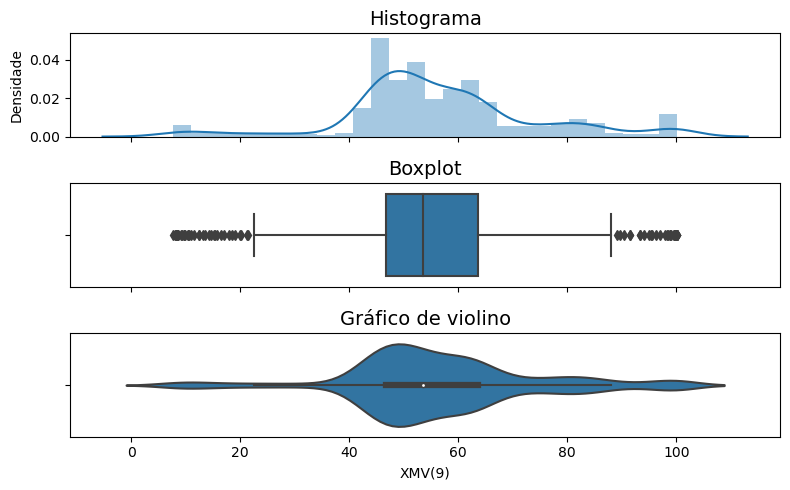

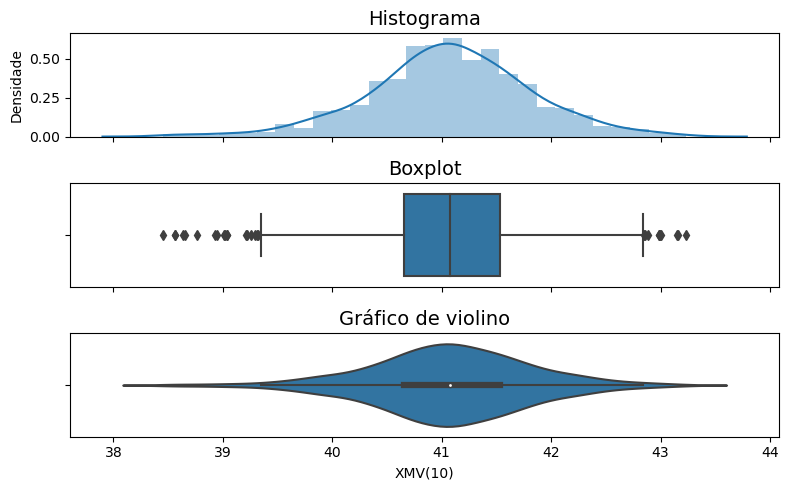

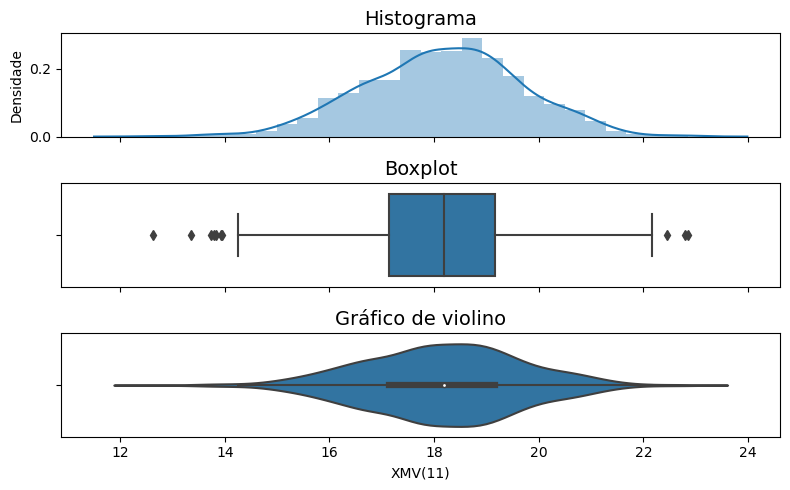

In [28]:
# Histograma / Boxplot / Gráfico de violino

for col in data_to_plot.columns:
    plot_comparison(data_to_plot[col], col)

In [29]:
# Skewness e kurtosis 

sk_kr = pd.DataFrame(fault_data.kurt(), columns=['kurtosis_full'])
sk_kr['skewness_full'] = fault_data.skew()

sk_kr['kurtosis_normal'] = fault_data[fault_data['STATUS'] == 0].kurt()
sk_kr['skewness_normal'] = fault_data[fault_data['STATUS'] == 0].skew()

sk_kr['kurtosis_faulty'] = fault_data[fault_data['STATUS'] != 0].kurt()
sk_kr['skewness_faulty'] = fault_data[fault_data['STATUS'] != 0].skew()

sk_kr[:-1]

,kurtosis_full,skewness_full,kurtosis_normal,skewness_normal,kurtosis_faulty,skewness_faulty
XMEAS(1),-1.548091,0.068172,4.897937,1.322345,4.499872,-1.267332
XMEAS(2),-0.106757,-0.036723,-0.216851,0.137392,-0.124738,-0.141203
XMEAS(3),1.753645,-0.397177,1.109712,0.274272,1.349295,-0.553827
XMEAS(4),-0.226334,-0.206773,1.221544,0.346187,0.659026,-0.196278
XMEAS(5),0.069211,-0.042520,0.019584,-0.100602,0.145679,0.021212
XMEAS(6),-0.022558,-0.066349,-0.129660,-0.107366,0.069402,-0.000373
XMEAS(7),2.331504,0.592202,1.872643,-0.647394,1.487387,1.033806
XMEAS(8),0.895450,0.054977,0.878700,-0.163321,0.648059,0.068332
XMEAS(9),0.050350,0.197296,0.110556,0.190430,-0.036939,0.197022
XMEAS(10),0.571416,-0.163941,1.467465,-0.209777,0.753540,0.033216


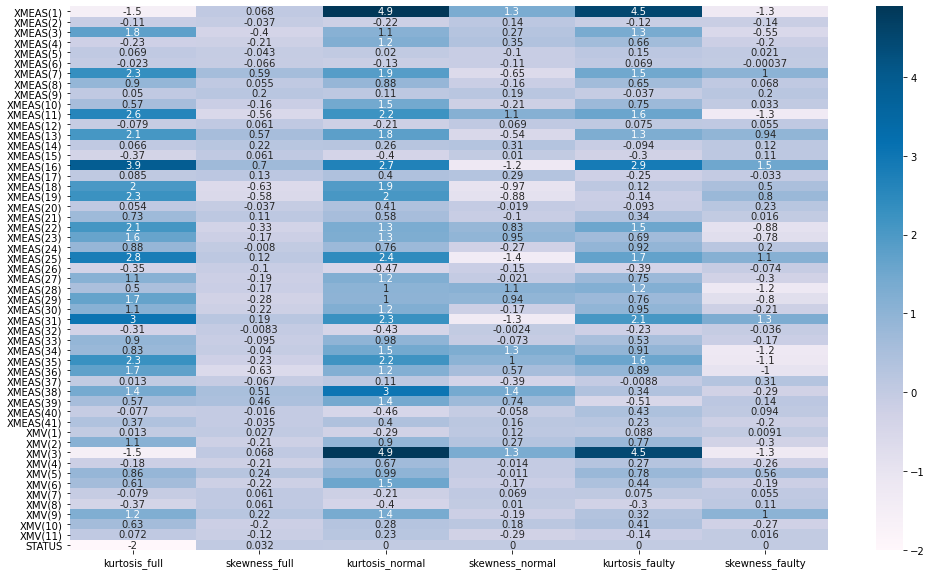

In [30]:
plt.figure(figsize=(17,10))
ax = sns.heatmap(sk_kr, annot=True, cmap='PuBu')
plt.show();

### Cenários - 1 semana de operação


(2940, 54)
Min. timestamp:  2019-04-13 00:00:00
Max. timestamp:  2019-04-19 02:57:00


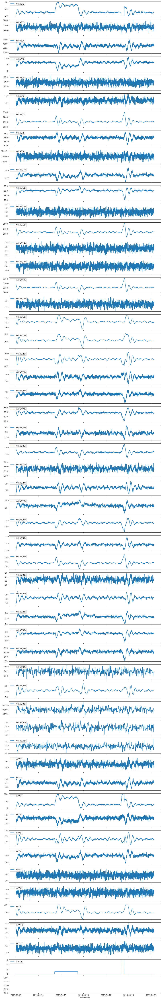

In [31]:
fig, ax = plt.subplots(nrows=data.shape[1], ncols=1, sharex=True, figsize=(15,100))
columns = data.columns[1:]

fault_data = data[48960:51900].copy() #9120:12480

print()
print(fault_data.shape)
print("Min. timestamp: ", fault_data['timestamp'].min())
print("Max. timestamp: ", fault_data['timestamp'].max())

for i in range (data.shape[1]-1):

    ax[i].plot(fault_data['timestamp'], fault_data[columns[i]], label=columns[i])
    ax[i].legend(loc='upper left')
    
#     ax[i].axvline(fault_data[fault_data['STATUS'] != 0].timestamp.min(), c='green')
#     ax[i].axvline(fault_data[fault_data['STATUS'] != 0].timestamp.max(), c='green')

plt.xlabel('Timestamp');

In [32]:
fault_data.STATUS.unique()

array([0, 1, 6], dtype=int64)

In [33]:
fault_data.describe().T

,count,mean,std,min,25%,50%,75%,max
XMEAS(1),2940.0,0.335333,0.217141,-0.003742,0.225635,0.259640,0.322269,1.006564
XMEAS(2),2940.0,3662.658414,36.800566,3521.534156,3638.112631,3661.986495,3686.798023,3794.691242
XMEAS(3),2940.0,4502.943536,71.289423,4188.186993,4467.711064,4505.279999,4540.272064,4821.226605
XMEAS(4),2940.0,9.248164,0.300724,7.946036,9.169993,9.318482,9.414814,10.179498
XMEAS(5),2940.0,26.898096,0.214149,26.150180,26.756193,26.897503,27.044490,27.634316
XMEAS(6),2940.0,42.327214,0.249367,41.307552,42.165976,42.329021,42.484746,43.233196
XMEAS(7),2940.0,2707.892077,31.222269,2610.925815,2696.822893,2705.119278,2714.167712,2891.525759
XMEAS(8),2940.0,74.998037,1.023268,70.272042,74.486335,74.969511,75.475568,79.304469
XMEAS(9),2940.0,120.399984,0.019535,120.333879,120.386625,120.400166,120.412824,120.466624
XMEAS(10),2940.0,0.333456,0.022736,0.242128,0.322456,0.335072,0.345408,0.436532


C:\Users\anaso\AppData\Local\Continuum\anaconda3\envs\doc-ana\lib\site-packages\pandas\plotting\_matplotlib\tools.py:400: MatplotlibDeprecationWarning: 
The is_first_col function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use ax.get_subplotspec().is_first_col() instead.
  if ax.is_first_col():
C:\Users\anaso\AppData\Local\Continuum\anaconda3\envs\doc-ana\lib\site-packages\pandas\plotting\_matplotlib\tools.py:400: MatplotlibDeprecationWarning: 
The is_first_col function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use ax.get_subplotspec().is_first_col() instead.
  if ax.is_first_col():
C:\Users\anaso\AppData\Local\Continuum\anaconda3\envs\doc-ana\lib\site-packages\pandas\plotting\_matplotlib\tools.py:400: MatplotlibDeprecationWarning: 
The is_first_col function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use ax.get_subplotspec().is_first_col() instead.
  if ax.is_first_col():
C:\User

C:\Users\anaso\AppData\Local\Continuum\anaconda3\envs\doc-ana\lib\site-packages\pandas\plotting\_matplotlib\tools.py:400: MatplotlibDeprecationWarning: 
The is_first_col function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use ax.get_subplotspec().is_first_col() instead.
  if ax.is_first_col():
C:\Users\anaso\AppData\Local\Continuum\anaconda3\envs\doc-ana\lib\site-packages\pandas\plotting\_matplotlib\tools.py:400: MatplotlibDeprecationWarning: 
The is_first_col function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use ax.get_subplotspec().is_first_col() instead.
  if ax.is_first_col():
C:\Users\anaso\AppData\Local\Continuum\anaconda3\envs\doc-ana\lib\site-packages\pandas\plotting\_matplotlib\tools.py:400: MatplotlibDeprecationWarning: 
The is_first_col function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use ax.get_subplotspec().is_first_col() instead.
  if ax.is_first_col():
C:\User

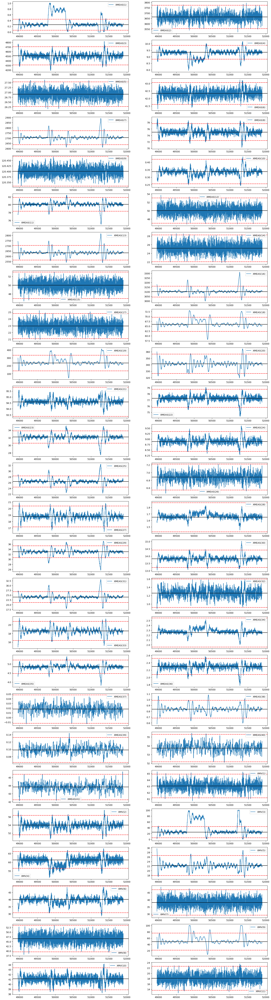

In [34]:
# Obtenção das cartas de controle
data_to_plot = fault_data.drop(['STATUS', 'timestamp'], axis=1)
fig, ax = plt.subplots(math.ceil(data_to_plot.shape[1]/2), 2, figsize=(20,80), dpi=100)

for i in range(data_to_plot.shape[1]):
    
    x = data_to_plot.iloc[:,i]
    x.plot(ax=ax.ravel()[i]) 

    ax.ravel()[i].legend();
    ax.ravel()[i].axhline(carta_stats['mean'][i],c='k')
    ax.ravel()[i].axhline(carta_stats['LCL'][i],ls='--',c='r')
    ax.ravel()[i].axhline(carta_stats['UCL'][i],ls='--',c='r')

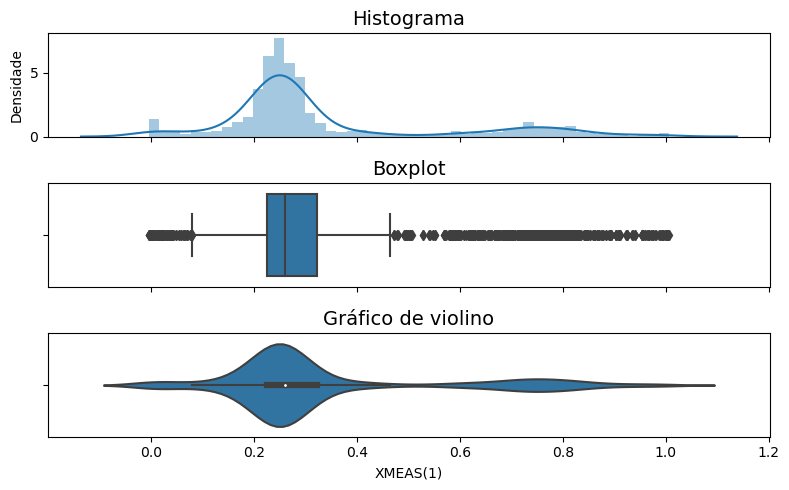

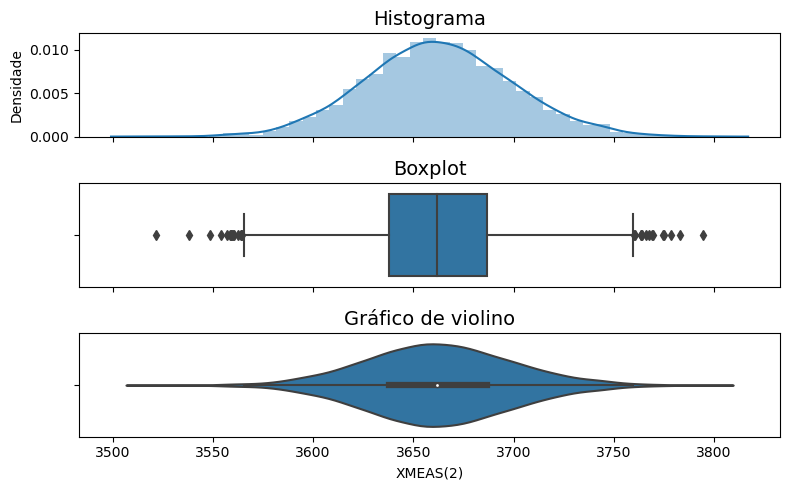

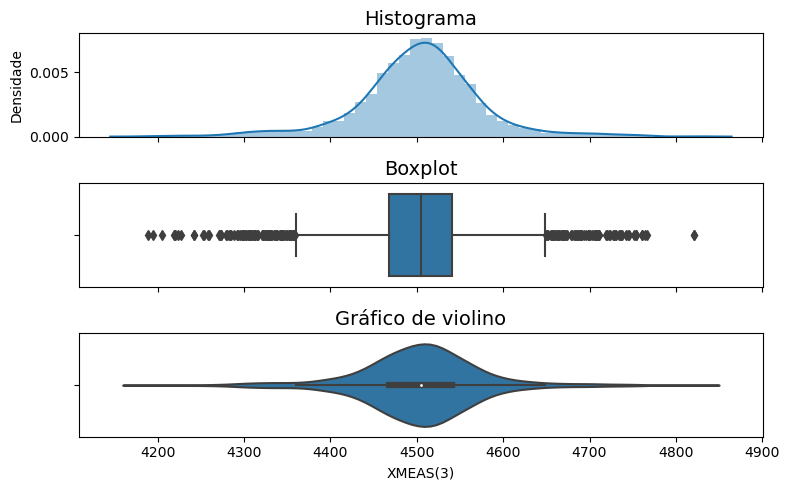

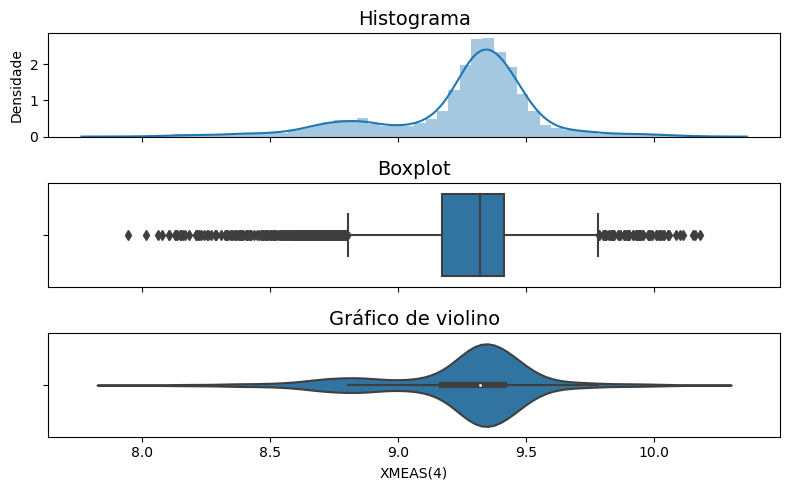

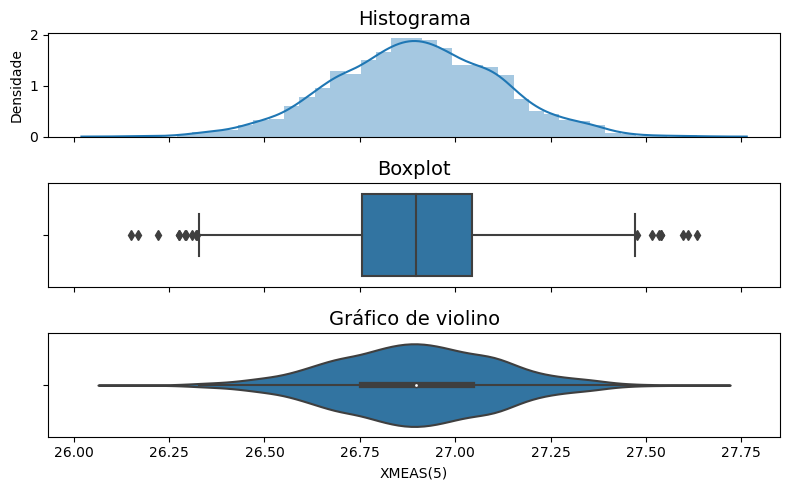

...

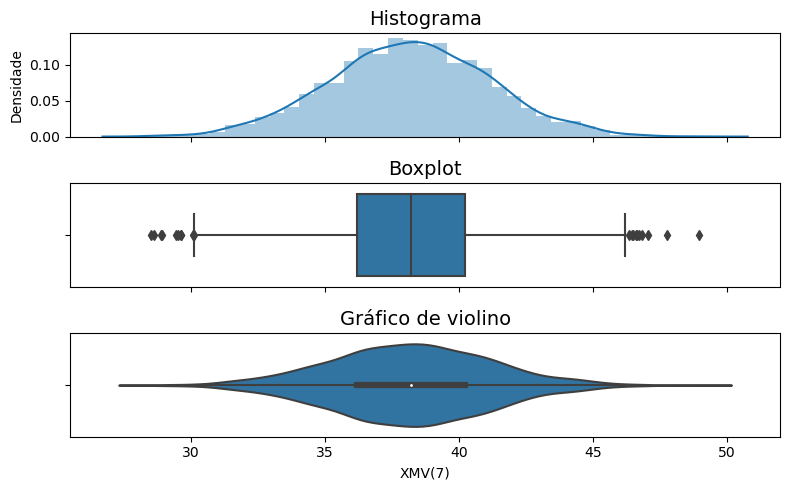

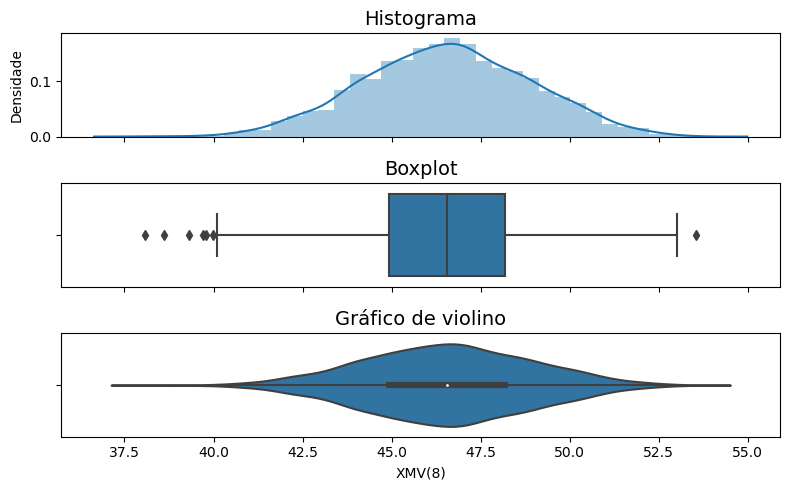

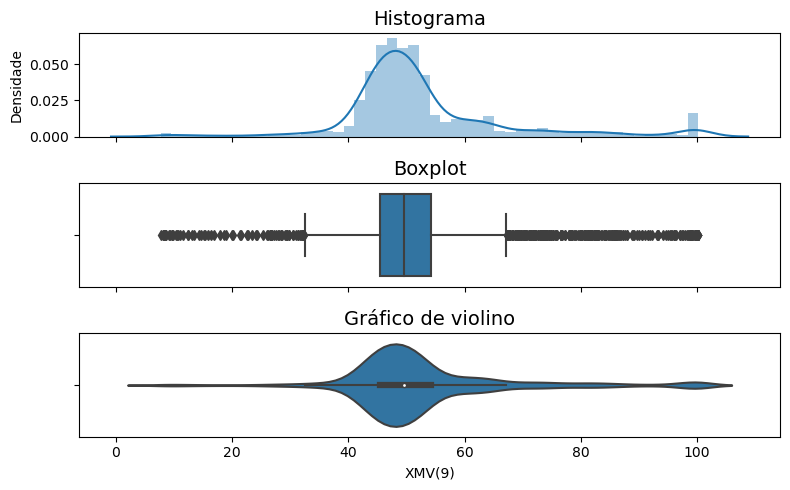

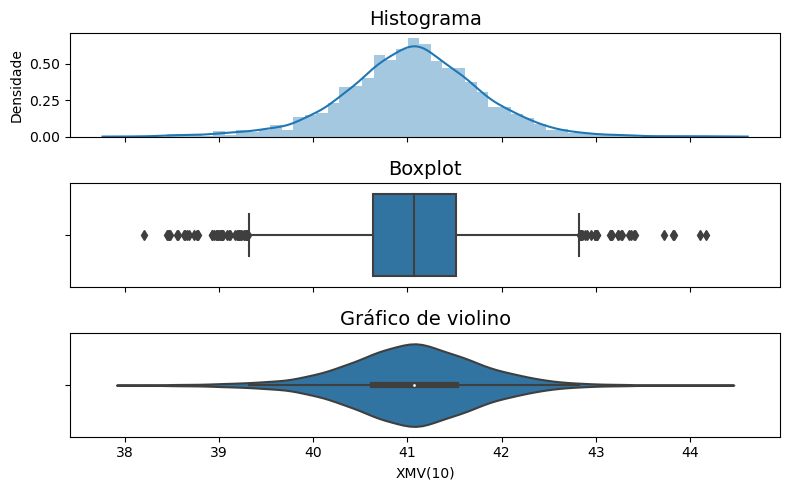

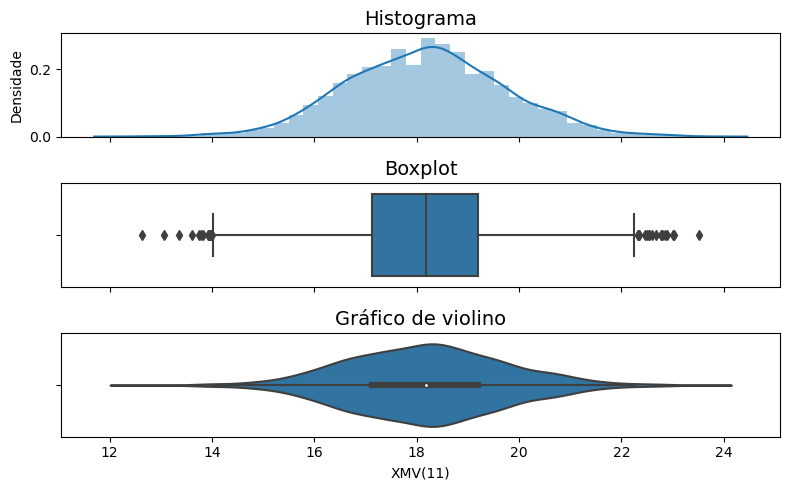

In [35]:
# Histograma / Boxplot / Gráfico de violino

for col in data_to_plot.columns:
    plot_comparison(data_to_plot[col], col)

In [36]:
# Skewness e kurtosis

sk_kr = pd.DataFrame(fault_data.kurt(), columns=['kurtosis_full'])
sk_kr['skewness_full'] = fault_data.skew()

sk_kr['kurtosis_normal'] = fault_data[fault_data['STATUS'] == 0].kurt()
sk_kr['skewness_normal'] = fault_data[fault_data['STATUS'] == 0].skew()

sk_kr['kurtosis_faulty'] = fault_data[fault_data['STATUS'] != 0].kurt()
sk_kr['skewness_faulty'] = fault_data[fault_data['STATUS'] != 0].skew()

sk_kr[:-1]

,kurtosis_full,skewness_full,kurtosis_normal,skewness_normal,kurtosis_faulty,skewness_faulty
XMEAS(1),0.896991,1.342474,6.612899,1.540904,1.546204,-1.633806
XMEAS(2),0.075359,0.058866,0.041475,0.129244,0.046352,-0.138562
XMEAS(3),2.412310,-0.164222,2.386647,0.088338,1.709594,-0.603649
XMEAS(4),1.751436,-1.000533,4.981975,-0.663032,0.099488,0.404112
XMEAS(5),-0.006885,-0.016383,-0.023200,-0.029494,0.099054,0.035781
XMEAS(6),0.324524,-0.042206,0.401308,-0.051855,0.141123,0.046953
XMEAS(7),8.328759,1.717309,13.325413,1.758197,1.319429,1.180213
XMEAS(8),2.593821,0.041857,3.164291,-0.004539,0.859421,0.153604
XMEAS(9),0.007358,0.024627,0.005781,-0.015457,-0.031579,0.160306
XMEAS(10),2.549156,-0.125374,3.733202,-0.057488,0.763433,-0.048518


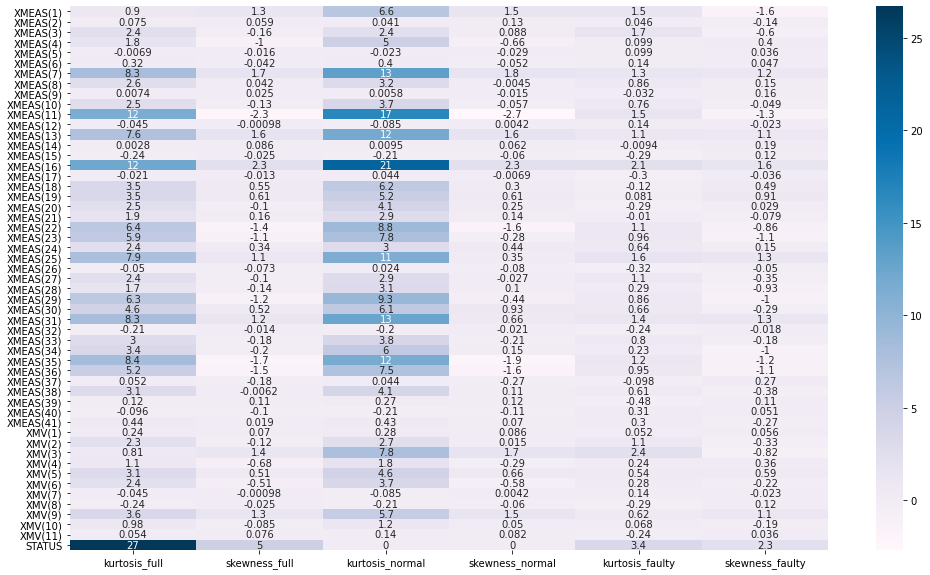

In [37]:
plt.figure(figsize=(17,10))
ax = sns.heatmap(sk_kr, annot=True, cmap='PuBu')
plt.show();

# Rascunho

In [ ]:
# pra não perder

# Years under consideration
years = [2019, 2020, 2021]
columns = np.sort(data['STATUS'].unique())[1:]

colors = plt.cm.OrRd(np.linspace(0, 0.7, len(years)))
index = np.arange(len(columns)+1) #+ 0.3
bar_width = 0.7
y_offset = np.zeros(len(columns))
cell_text = []
n_rows = len(ggg)

plt.figure(figsize=(12,3), dpi=300)

for row in range(n_rows):
    plot = plt.bar(index[1:], ggg[years[row]][1:], bar_width, bottom=y_offset, color=colors[row])
    y_offset = y_offset + ggg[years[row]][1:]
    cell_text.append(['%1.1f' % (x) for x in y_offset])
    i=0
    
    # Each iteration of this for loop, labels each bar with corresponding value
    for rect in plot:
        height = rect.get_height()
        plt.text(rect.get_x() + rect.get_width()/2, y_offset[i],'%d' % int(y_offset[i]), \
                 ha='center', va='bottom', fontsize=6)
        i=i+1
    
# Add a table to the bottom of the axes
the_table = plt.table(cellText=cell_text, rowLabels=years, rowColours=colors, colLabels=columns, loc='bottom')
plt.ylabel("nº de instâncias")
plt.xticks([])
plt.title('Quantidade de ocorrências de falhas/Ano')
plt.show()

In [ ]:
fig, ax = plt.subplots(nrows=4, ncols=1, sharex=True, figsize=(15,10))

ax[0].plot(data['timestamp'][35000:35900], data['STATUS'][35000:35900], label='STATUS')
ax[0].legend(loc='upper left')
ax[0].set_title("IDV(4) - Reactor cooling water inlet temperature (STEP)")

ax[1].plot(data['timestamp'][35000:35900], data['XMEAS(9)'][35000:35900], label='XMEAS(9)')
ax[1].legend(loc='upper left')

ax[2].plot(data['timestamp'][35000:35900], data['XMEAS(21)'][35000:35900], label='XMEAS(21)')
ax[2].legend(loc='upper left')

ax[3].plot(data['timestamp'][35000:35900], data['XMV(10)'][35000:35900], label='XMV(10)');
ax[3].legend(loc='upper left')

plt.xlabel('Timestamp');

In [ ]:
sns.lineplot(data=fault_data, x='timestamp', y='XMEAS(1)', hue='STATUS', palette=['blue','black'], linewidth=1)

In [ ]:
# Tentativa de colorir trechos específicos da linha do gráfico
# Deu certo só pra primeira variável

columns = data.columns[1:]
fault_data = data[49500:50500].copy()

print()
print(fault_data.shape)
print("Min. timestamp: ", fault_data['timestamp'].min())
print("Max. timestamp: ", fault_data['timestamp'].max())

for i in range (fault_data.shape[1]-1):
    
    x = fault_data.index.tolist()#fault_data['timestamp']#.tolist()
    y = fault_data[columns[i]].tolist()
    z = np.array(list(y))

    points = np.array([x, y]).T.reshape(-1, 1, 2)
    segments = np.concatenate([points[:-1], points[1:]], axis=1)

    cmap = ListedColormap(['blue', 'black'])
    # norm = BoundaryNorm([0, 4, 10], cmap.N)

    lc = LineCollection(segments, cmap=cmap)#, norm=norm)
    lc.set_array(z)

    plt.figure(figsize=(12,3))
    plt.gca().add_collection(lc)
    plt.xlim(min(x), max(x))
    plt.ylim(min(y), max(y))

In [ ]:
# Tentativa de colorir trechos específicos da linha do gráfico
fig, ax = plt.subplots()

def plot_func(group):
    global ax
    color = 'blue' if (fault_data['STATUS'] == 0).all() else 'black'
#     LABEL_COLOR_MAP = {0:'blue', 1:'black'}
#     color = [LABEL_COLOR_MAP[l] for l in fault_data['STATUS']]
    lw = 1.0
    ax.plot(fault_data['timestamp'], fault_data['XMEAS(1)'], c=color, linewidth=lw)

fault_data['XMEAS(1)'].apply(plot_func)

ax.legend(loc='best');

In [ ]:
# Tentativa de colorir trechos específicos da linha do gráfico
fig, ax = plt.subplots(nrows=data.shape[1], ncols=1, sharex=True, figsize=(15,100))
columns = data.columns[1:]

fault_data = data[49500:50500].copy()

LABEL_COLOR_MAP = {0:'blue', 1:'black'}
label_color = [LABEL_COLOR_MAP[l] for l in fault_data['STATUS']]

print()
print(fault_data.shape)
print("Min. timestamp: ", fault_data['timestamp'].min())
print("Max. timestamp: ", fault_data['timestamp'].max())

for i in range (fault_data.shape[1]-1):

    ax[i].plot(fault_data['timestamp'], fault_data[columns[i]], label=columns[i], color=label_color)
    ax[i].legend(loc='upper left')
    
    ax[i].axvline(fault_data[fault_data['STATUS'] != 0].timestamp.min(), c='green')
    ax[i].axvline(fault_data[fault_data['STATUS'] != 0].timestamp.max(), c='green')

plt.xlabel('Timestamp');